# RAS Forecast Analysis and Modeling

In [2]:
%load_ext autoreload
%autoreload

#%autoreload
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
display(HTML("""<style>div.output_area{max-height:10000px;overflow:scroll;}</style>"""))

import pandas as pd
pd.set_option("display.max_rows",1000)
pd.set_option("display.max_columns",500)
pd.set_option('precision', 3)

from os.path import join
from os import listdir
from glob import glob
from pandas import read_csv, read_excel, Series, DataFrame, to_numeric, concat
from sklearn.externals import joblib
from pandas import crosstab

#import geopandas as gpd

import matplotlib.pyplot as plt
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

#from pmdarima.arima import auto_arima

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
# Notes:

#There is a more recent scenarios. Discuss to Nancy/
# Jeff says Make a New Model. Hold constant at fix share of market * 0.72
#   - Study how to measure market share (Import/Export vs survey vs POS) talk to Nancy about the bias of the various approaches.
#   - GDOs last longer now compared to the last time 
#   - July 11th there is a big meeting for Jeff

In [4]:
import datetime as dt
start = dt.datetime.now()
print("Notebook Last Run Initiated: "+str(start))

Notebook Last Run Initiated: 2019-07-08 22:01:46.162549


In [5]:
def highlight_max(s):
    '''
    highlight the maximum in a Series yellow.
    '''
    is_max = s == s.max()
    return ['background-color: yellow' if v else '' for v in is_max]

def color_negative_red(val):
    """
    Takes a scalar and returns a string with
    the css property `'color: red'` for negative
    strings, black otherwise.
    """
    color = 'red' if val < 0 else 'black'
    return 'color: %s' % color

# Load Excel Files

In [6]:
files = glob("*GDO Units*.xlsx")
files

['2013-June 2019 GDO Units by month.xlsx',
 '2013-May 2019 GDO Units by month.xlsx']

In [15]:
ifile = files[0]
print("Loading {0}".format(ifile))
data = read_excel(ifile)
data = data.fillna(0)
data["Prd.Ctg"][data["Prd.Ctg"] == "AccessMaster Series"] = "Contractor"
data = data[~data["Prd.Ctg"].isin(["Displays", "Null", "Light Duty Operator"])]
data.index = data[list(data.columns[:4])].apply(lambda x: ' :: '.join(str(y) for y in x), axis=1)
data.drop(list(data.columns[:4]), axis=1, inplace=True)
data.columns = [x.title() for x in data.columns]
from datetime import datetime
cols = [datetime.strptime(x, '%b %Y') for x in data.columns]
data.columns = cols

rdata = read_excel(glob("*Census*")[0])
regionVal = -1
divisionVal = -1
regionMap = {}
divisionMap = {}
for row,rowdata in rdata.iterrows():
    name = rowdata["Name"]
    if name.endswith("Region"):
        regionName = name.replace("Region", "").strip()
    elif name.endswith("Division"):
        divisionName = name.replace("Division", "").strip()
    else:
        stateName = name
        regionMap[stateName] = regionName
        divisionMap[stateName] = divisionName
        
latin  = {'Costa Rica', 'Distrito Federal', 'El Salvador', 'Ecuador', 'Jamaica', 'Panama', 'Lima y Callao', 'Virgin Islands', 'Tamaulipas', 'ATLANTICO', 'Guatemala', 'Barbados', 'BOGOTA', 'Sonora', 'Puerto Rico', 'Amer.Virgin Is.', 'Honduras'}
canada = {'Alberta', 'British Columbia', 'Manitoba', 'New Brunswick', 'Newfoundland & Labr.', 'Northwest Terr.', 'Nova Scotia', 'Nunavut', 'Ontario', 'Prince Edward Island', 'Quebec', 'Saskatchewan','Yukon Territory'}
for stateName in latin:
    regionMap[stateName] = "Latin"
    divisionMap[stateName] = "Latin"
for stateName in canada:
    regionMap[stateName] = "Canada"
    divisionMap[stateName] = "Canada"
    
stateNames = [x[-2] for x in data.index.str.split(" :: ")]
data["region"] = [regionMap[name] for name in stateNames]
data = data[~data["region"].isin(["Latin", "Canada"])]
data.drop(["region"], axis=1, inplace=True)
print(data.values.sum())
# May 19139950.0
# June 19374670.0
data.head()

Loading 2013-June 2019 GDO Units by month.xlsx
19374670.0


/anaconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


,2013-01-01 00:00:00,2013-02-01 00:00:00,2013-03-01 00:00:00,2013-04-01 00:00:00,2013-05-01 00:00:00,2013-06-01 00:00:00,2013-07-01 00:00:00,2013-08-01 00:00:00,2013-09-01 00:00:00,2013-10-01 00:00:00,2013-11-01 00:00:00,2013-12-01 00:00:00,2014-01-01 00:00:00,2014-02-01 00:00:00,2014-03-01 00:00:00,2014-04-01 00:00:00,2014-05-01 00:00:00,2014-06-01 00:00:00,2014-07-01 00:00:00,2014-08-01 00:00:00,2014-09-01 00:00:00,2014-10-01 00:00:00,2014-11-01 00:00:00,2014-12-01 00:00:00,2015-01-01 00:00:00,2015-02-01 00:00:00,2015-03-01 00:00:00,2015-04-01 00:00:00,2015-05-01 00:00:00,2015-06-01 00:00:00,2015-07-01 00:00:00,2015-08-01 00:00:00,2015-09-01 00:00:00,2015-10-01 00:00:00,2015-11-01 00:00:00,2015-12-01 00:00:00,2016-01-01 00:00:00,2016-02-01 00:00:00,2016-03-01 00:00:00,2016-04-01 00:00:00,2016-05-01 00:00:00,2016-06-01 00:00:00,2016-07-01 00:00:00,2016-08-01 00:00:00,2016-09-01 00:00:00,2016-10-01 00:00:00,2016-11-01 00:00:00,2016-12-01 00:00:00,2017-01-01 00:00:00,2017-02-01 00:00:00,2017-03-01 00:00:00,2017-04-01 00:00:00,2017-05-01 00:00:00,2017-06-01 00:00:00,2017-07-01 00:00:00,2017-08-01 00:00:00,2017-09-01 00:00:00,2017-10-01 00:00:00,2017-11-01 00:00:00,2017-12-01 00:00:00,2018-01-01 00:00:00,2018-02-01 00:00:00,2018-03-01 00:00:00,2018-04-01 00:00:00,2018-05-01 00:00:00,2018-06-01 00:00:00,2018-07-01 00:00:00,2018-08-01 00:00:00,2018-09-01 00:00:00,2018-10-01 00:00:00,2018-11-01 00:00:00,2018-12-01 00:00:00,2019-01-01 00:00:00,2019-02-01 00:00:00,2019-03-01 00:00:00,2019-04-01 00:00:00,2019-05-01 00:00:00,2019-06-01 00:00:00
RAS Retail :: US/AK :: Alaska :: Basic,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
RAS Retail :: US/AK :: Alaska :: Comfort,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
RAS Retail :: US/AK :: Alaska :: Premium,0.0,0.0,0.0,0.0,2.0,0.0,2.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,2.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
RAS Retail :: US/AL :: Alabama :: Basic,372.0,0.0,266.0,741.0,593.0,698.0,538.0,384.0,362.0,524.0,589.0,62.0,397.0,618.0,598.0,421.0,670.0,463.0,439.0,439.0,418.0,372.0,504.0,6.0,137.0,318.0,312.0,301.0,358.0,520.0,471.0,493.0,940.0,243.0,475.0,563.0,440.0,576.0,523.0,716.0,449.0,767.0,693.0,1145.0,741.0,1840.0,1134.0,833.0,488.0,716.0,882.0,535.0,623.0,568.0,834.0,1441.0,424.0,393.0,504.0,1058.0,1225.0,936.0,1219.0,504.0,1585.0,904.0,1443.0,1071.0,638.0,1120.0,394.0,1143.0,1146.0,487.0,659.0,695.0,996.0,1062.0
RAS Retail :: US/AL :: Alabama :: Comfort,376.0,0.0,166.0,531.0,79.0,643.0,391.0,331.0,285.0,354.0,289.0,254.0,475.0,582.0,434.0,386.0,518.0,2243.0,276.0,729.0,357.0,398.0,311.0,306.0,433.0,528.0,953.0,270.0,485.0,1261.0,893.0,668.0,1377.0,425.0,411.0,807.0,1030.0,1237.0,1104.0,546.0,308.0,1995.0,486.0,1147.0,1216.0,498.0,714.0,467.0,1176.0,699.0,895.0,426.0,441.0,501.0,910.0,995.0,505.0,1309.0,144.0,314.0,19.0,171.0,210.0,243.0,382.0,275.0,488.0,391.0,193.0,113.0,239.0,103.0,364.0,244.0,155.0,202.0,484.0,243.0


In [64]:
ifile = glob("*GDO NET UNITS*.xlsx")[0]
print("Loading {0}".format(ifile))
data = read_excel(ifile)
data.columns = ["Source"] + list(range(1997, 2019))
data.head()
data = data[data["Source"].isin(["Sears", "Chamberlain", "LiftMaster", "Liftmaster", "Lift-Master US", "Lift-Master", "Access Master"])]
data["Source"][data["Source"].str.startswith("Lift")] = "LiftMaster"
data["Source"].value_counts()

Loading 12.2018 - Historic GDO NET UNITS.xlsx


Chamberlain      5
LiftMaster       5
Sears            5
Access Master    4
Name: Source, dtype: int64

In [129]:
accs = {}
for acc,accdata in data.groupby("Source"):
    q1 = accdata.iloc[0][1:]
    q2 = accdata.iloc[1][1:]
    q3 = accdata.iloc[2][1:]
    q4 = accdata.iloc[3][1:]

    sdata = []
    cols = date_range("1997-01-01", freq='Q', periods=88)
    for i in range(len(q1)):
        sdata.append(q1.iloc[i])
        sdata.append(q2.iloc[i])
        sdata.append(q3.iloc[i])
        sdata.append(q4.iloc[i])
    accs[acc] = Series(sdata, index=cols)
    
daccs = DataFrame(accs)
daccs["Total"] = daccs.sum(axis=1)

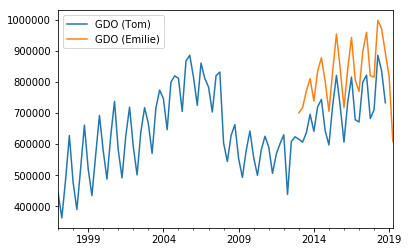

In [146]:
daccs["Total"].plot(label="GDO (Tom)")
data.sum().resample("Q").sum().plot(label="GDO (Emilie)")
plt.legend(loc='best')
plt.savefig('hi.png')

In [171]:
em = DataFrame(data.sum().resample("Q").sum())[:-2][0]

In [176]:
tmp = DataFrame([daccs["Total"]]).T
tm = tmp[64:]["Total"]
#DataFrame([em, tmp[64:]])
vals = DataFrame([em,tm]).T
vals.columns = ["Emilie", "Tom"]
vals["Diff"] = vals["Emilie"] - vals["Tom"]

In [178]:
vals.to_excel("RAS GDO Comparison.xlsx")

In [115]:
x = to_datetime(q1[1:].index, format='%Y')
for y in x:
    print(y.to_period(freq='Q').to_timestamp(how='E'))
    
#to_datetime([1997]*3, format='%Y').to_period(freq='Q')

1997-03-31 23:59:59.999999999
1998-03-31 23:59:59.999999999
1999-03-31 23:59:59.999999999
2000-03-31 23:59:59.999999999
2001-03-31 23:59:59.999999999
2002-03-31 23:59:59.999999999
2003-03-31 23:59:59.999999999
2004-03-31 23:59:59.999999999
2005-03-31 23:59:59.999999999
2006-03-31 23:59:59.999999999
2007-03-31 23:59:59.999999999
2008-03-31 23:59:59.999999999
2009-03-31 23:59:59.999999999
2010-03-31 23:59:59.999999999
2011-03-31 23:59:59.999999999
2012-03-31 23:59:59.999999999
2013-03-31 23:59:59.999999999
2014-03-31 23:59:59.999999999
2015-03-31 23:59:59.999999999
2016-03-31 23:59:59.999999999
2017-03-31 23:59:59.999999999
2018-03-31 23:59:59.999999999


In [90]:
#df.index.to_period("Q")
#.dt.to_period("Q")
vals = ["{0}".format(x) for x in list(q1[1:].index)]
print(vals)
from pandas import to_datetime
to_datetime(vals, format='%Y-%q')

['1997-01', '1998-01', '1999-01', '2000-01', '2001-01', '2002-01', '2003-01', '2004-01', '2005-01', '2006-01', '2007-01', '2008-01', '2009-01', '2010-01', '2011-01', '2012-01', '2013-01', '2014-01', '2015-01', '2016-01', '2017-01', '2018-01']


ValueError: 'q' is a bad directive in format '%Y-%q'

In [79]:
from pandas import Period
help(Period)
#Period(freq='Q-JUL', year=2006, quarter=1)

Help on class Period in module pandas._libs.tslibs.period:

class Period(_Period)
 |  Period(value=None, freq=None, ordinal=None, year=None, month=None, quarter=None, day=None, hour=None, minute=None, second=None)
 |  
 |  Represents a period of time
 |  
 |  Parameters
 |  ----------
 |  value : Period or compat.string_types, default None
 |      The time period represented (e.g., '4Q2005')
 |  freq : str, default None
 |      One of pandas period strings or corresponding objects
 |  year : int, default None
 |  month : int, default 1
 |  quarter : int, default None
 |  day : int, default 1
 |  hour : int, default 0
 |  minute : int, default 0
 |  second : int, default 0
 |  
 |  Method resolution order:
 |      Period
 |      _Period
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  __new__(cls, value=None, freq=None, ordinal=None, year=None, month=None, quarter=None, day=None, hour=None, minute=None, second=None)
 |  
 |  -----------------------------------------------

# Check Statistics

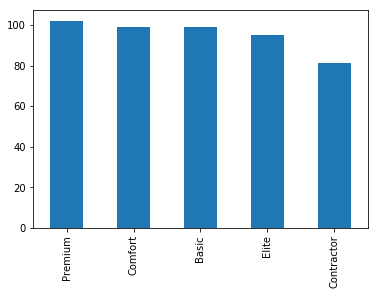

In [150]:
category = Series([x[-1] for x in data.index.str.split(" :: ")])
category.value_counts().plot('bar')

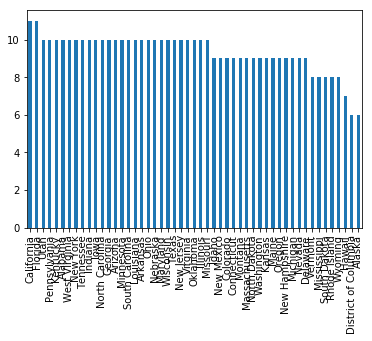

In [149]:
state = Series([x[-2] for x in data.index.str.split(" :: ")])
state.value_counts().plot('bar')

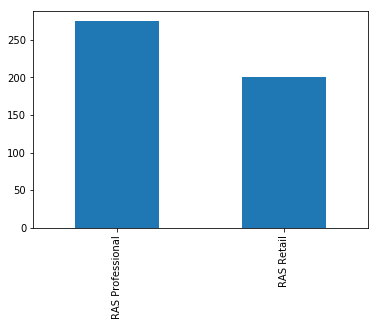

In [153]:
pc = Series([x[-4] for x in data.index.str.split(" :: ")])
pc.value_counts().plot('bar')

# Total Sales

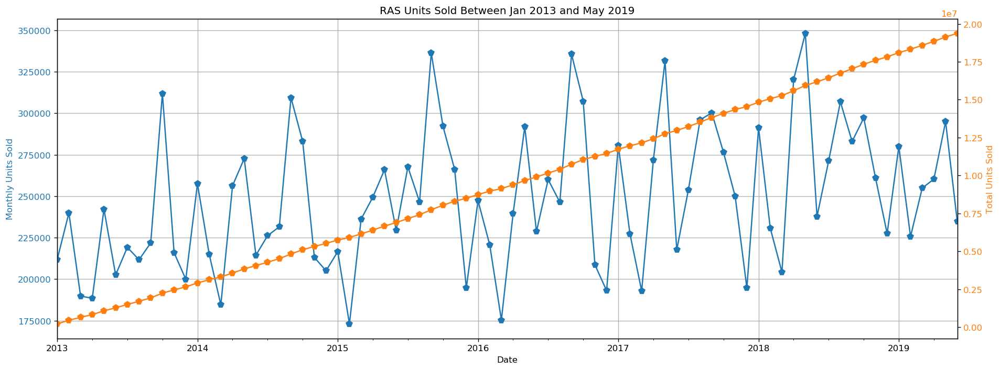

In [16]:
f, ax1 = plt.subplots(1, 1, figsize=(16,6))

localdata = data.copy()

## Monthly Values (Continuous)
plotdata = localdata.sum()
color = 'C0'
ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7, color=color)
ax1.set_ylabel("Monthly Units Sold", color=color)
ax1.set_xlabel("Date")
ax1.tick_params(axis='y', labelcolor=color)
ax1.set_title("RAS Units Sold Between Jan 2013 and May 2019")

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

plotdata = localdata.sum().cumsum()
color = 'C1'
ax2.set_ylabel('Total Units Sold', color=color)  # we already handled the x-label with ax1
ax2 = plotdata.plot(ax=ax2, style='-p', ms=7, color=color)
ax2.tick_params(axis='y', labelcolor=color)

f.tight_layout()  # otherwise the right y-label is slightly clipped

,2013,2014,2015,2016,2017,2018,2019
Jan,2.118e+05,2.575e+05,2.166e+05,2.473e+05,2.806e+05,2.913e+05,2.800e+05
Feb,4.517e+05,4.726e+05,3.896e+05,4.680e+05,5.078e+05,5.220e+05,5.056e+05
Mar,6.415e+05,6.571e+05,6.258e+05,6.434e+05,7.007e+05,7.262e+05,7.605e+05
Apr,8.299e+05,9.134e+05,8.752e+05,8.828e+05,9.723e+05,1.046e+06,1.021e+06
May,1.072e+06,1.186e+06,1.141e+06,1.175e+06,1.304e+06,1.395e+06,1.316e+06
Jun,1.275e+06,1.400e+06,1.371e+06,1.403e+06,1.522e+06,1.632e+06,1.550e+06
Jul,1.494e+06,1.627e+06,1.638e+06,1.663e+06,1.775e+06,1.904e+06,NaN
Aug,1.705e+06,1.858e+06,1.885e+06,1.910e+06,2.072e+06,2.211e+06,NaN
Sep,1.927e+06,2.168e+06,2.221e+06,2.245e+06,2.372e+06,2.494e+06,NaN
Oct,2.239e+06,2.451e+06,2.513e+06,2.552e+06,2.648e+06,2.791e+06,NaN


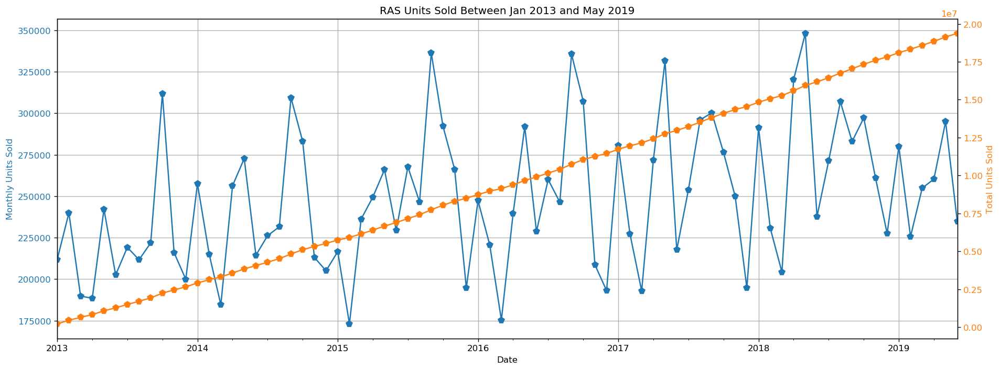

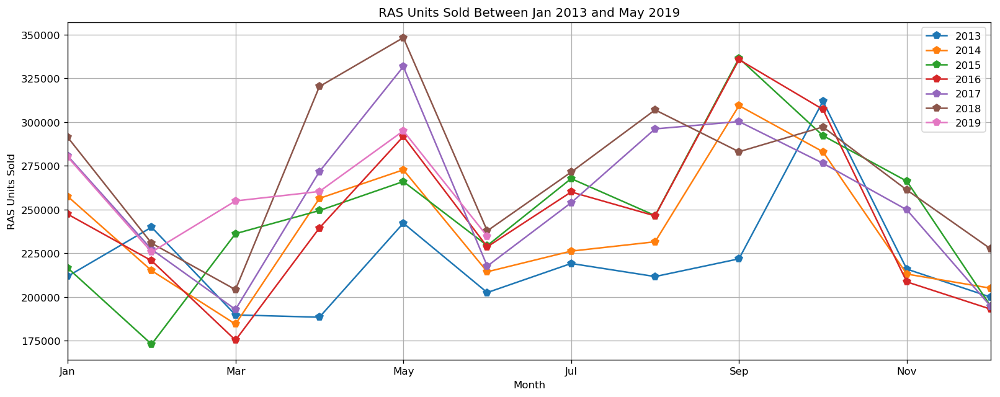

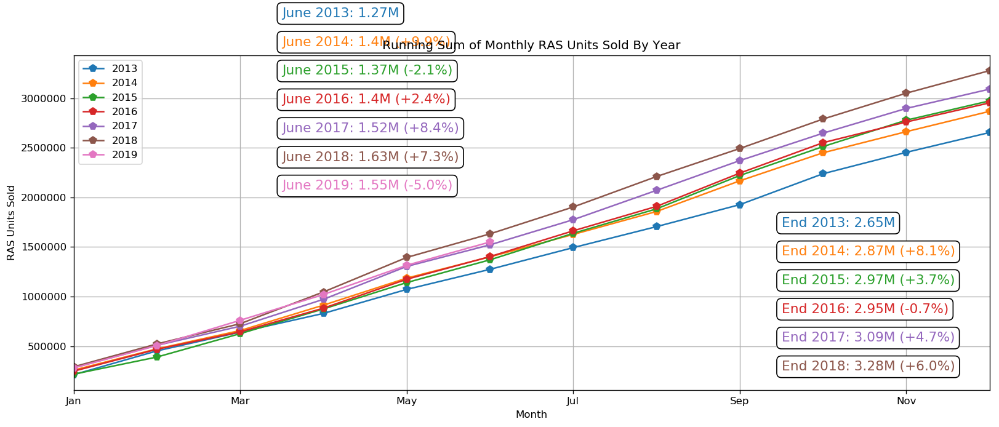

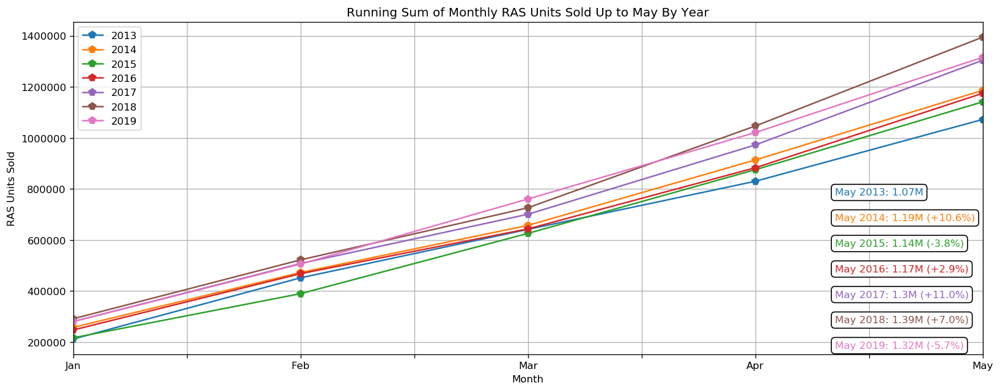

In [18]:
years = range(2013, 2019+1)
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct','Nov','Dec']
yeardata = {}

localdata = data.copy()

for year in years:
    localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
    sums = localyeardata.sum()
    sums.index = [datetime.strftime(x, "%m") for x in sums.index]
    yeardata[year] = sums

    
## Monthly Values (Continuous)
f, ax1 = plt.subplots(1, 1, figsize=(16,6))
plotdata = localdata.sum()
color = 'C0'
ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7, color=color)
ax1.set_ylabel("Monthly Units Sold", color=color)
ax1.set_xlabel("Date")
ax1.tick_params(axis='y', labelcolor=color)
ax1.set_title("RAS Units Sold Between Jan 2013 and May 2019")
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
plotdata = localdata.sum().cumsum()
color = 'C1'
ax2.set_ylabel('Total Units Sold', color=color)  # we already handled the x-label with ax1
ax2 = plotdata.plot(ax=ax2, style='-p', ms=7, color=color)
ax2.tick_params(axis='y', labelcolor=color)
f.tight_layout()  # otherwise the right y-label is slightly clipped  




## Monthly Values Overlaid by Year
f, ax1 = plt.subplots(1, 1, figsize=(16,6))
plotdata = DataFrame(yeardata)
plotdata.index = months
ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7)
ax1.set_title("RAS Units Sold Between Jan 2013 and May 2019")
ax1.set_ylabel("RAS Units Sold")
ax1.set_xlabel("Month")


csumdata = {}
for k,v in yeardata.items():
    csumdata[k] = v.cumsum()
csumdf = DataFrame(csumdata)
csumdf.index = months
f, ax1 = plt.subplots(1, 1, figsize=(16,6))
ax1 = csumdf.plot(ax=ax1, grid=True, style='-p', ms=7)
ax1.set_ylabel("RAS Units Sold")
ax1.set_xlabel("Month")
ax1.set_title("Running Sum of Monthly RAS Units Sold By Year")

if True:
    xs = [csumdf[y].iloc[5] for y in years]
    ts = ["June {0}".format(y) for y in years]
    ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
    for i in range(1,len(ts)):
        diff = round(100*(xs[i]/xs[i-1]-1),1)
        if diff > 0:
            ts[i] = "{0} (+{1}%)".format(ts[i], diff)
        else:
            ts[i] = "{0} ({1}%)".format(ts[i], diff)

    ymax = max(xs)
    for i in range(len(xs)):
        plt.text(2.5, (2.4*ymax) - 2.9e5*i, ts[i], {'color': "C{0}".format(i), 'fontsize': 13, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")

if True:
    xs = [csumdf[y].iloc[11] for y in years]
    ts = ["End {0}".format(y) for y in years]
    ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
    for i in range(1,len(ts)):
        diff = round(100*(xs[i]/xs[i-1]-1),1)
        if diff > 0:
            ts[i] = "{0} (+{1}%)".format(ts[i], diff)
        else:
            ts[i] = "{0} ({1}%)".format(ts[i], diff)

    ymin = max(xs)
    for i in range(len(xs)-1):
        plt.text(8.5, (0.55*ymin) - 2.9e5*i, ts[i], {'color': "C{0}".format(i), 'fontsize': 13, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")

        

f, ax1 = plt.subplots(1, 1, figsize=(16,6))
ax1 = csumdf[:5].plot(ax=ax1, grid=True, style='-p', ms=7)
ax1.set_ylabel("RAS Units Sold")
ax1.set_xlabel("Month")
ax1.set_title("Running Sum of Monthly RAS Units Sold Up to May By Year")


if True:
    xs = [csumdf[y].iloc[4] for y in years]
    ts = ["May {0}".format(y) for y in years]
    ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
    for i in range(1,len(ts)):
        diff = round(100*(xs[i]/xs[i-1]-1),1)
        if diff > 0:
            ts[i] = "{0} (+{1}%)".format(ts[i], diff)
        else:
            ts[i] = "{0} ({1}%)".format(ts[i], diff)

    ymin = min(xs)
    for i in range(len(xs)):
        plt.text(3.35, (0.75*ymin) - 1.0e5*i, ts[i], {'color': "C{0}".format(i), 'fontsize': 10, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")


csumdf

In [36]:
yd[2019].index

Index(['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12'], dtype='object')

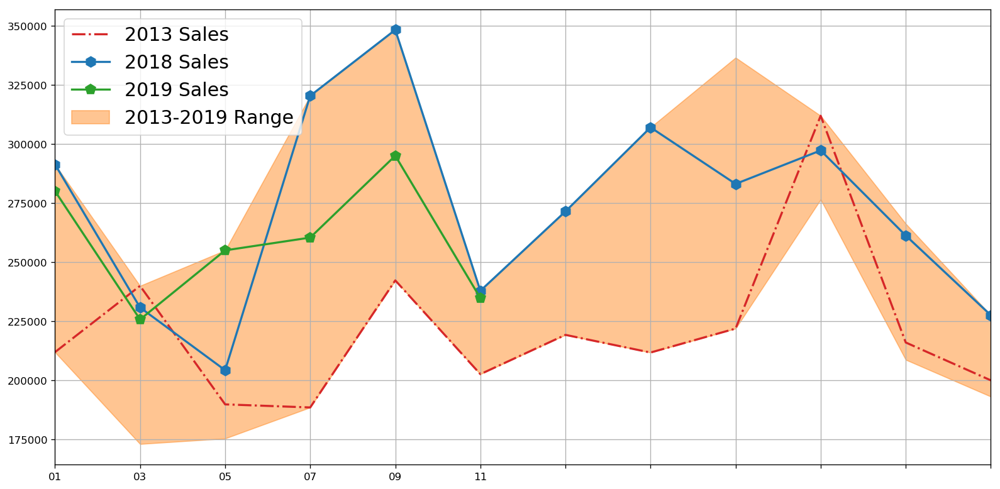

In [19]:
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct','Nov','Dec']
yd = DataFrame(yeardata)
#yd.index = months
lower = yd.min(axis=1)
upper = yd.max(axis=1)


f, ax = plt.subplots(1, 1, figsize=(16,8))
yd[2013].plot(ax=ax, grid=True, style='-.', ms=10, lw=2, color='C3', label="2013 Sales")
yd[2018].plot(ax=ax, grid=True, style='-h', ms=10, lw=2, color='C0', label="2018 Sales")
yd[2019].plot(ax=ax, grid=True, style='-p', ms=10, lw=2, color='C2', label="2019 Sales")
ax.fill_between(yd[2018].index, lower, upper, alpha=0.45, color='C1', label="2013-2019 Range")
ax.legend(loc='upper left', fontsize=18)

In [20]:
f, ax = plt.subplots(1, 1, figsize=(16,8))
prdf = 



col = 'C1'
ax = prdf["Data"].plot(ax=ax, style='--.', ms=12, label="Sales Data")
ax.set_ylabel("Units Sold in {0} [k]".format(freq))
ax.set_xlabel("Date")
ax.set_title("RAS Sales Forecast")
#ax.tick_params(axis='y', labelcolor=color)
ax.fill_between(prdf.index, prdf["Lower"], prdf["Upper"], alpha=0.45, color=col, label="Prediction Band")
#ax.fill_between(prdf.index, prdf["FC Lower"], prdf["FC Upper"], alpha=0.35, color='C2', label="Prediction Band")
ax = prdf["Central"].plot(ax=ax, grid=True, style='-', lw=0.5, color='black', label="Prediction Mean")
ax.legend(loc='best')

SyntaxError: invalid syntax (<ipython-input-20-ba9ae22f8c74>, line 2)

In [21]:
localdata = data.copy()
plotdata = DataFrame(localdata.sum(), columns=["Total"])
plotdata.to_pickle("Aggdata/TotalSales.p")

# Category Sales

In [22]:
catdata = data.copy()
catdata["Category"] = [x[-1] for x in data.index.str.split(" :: ")]

categorysales = {}

yeardata = {}
catyearmonthdata = {}
catyeardata = {}
catyearqtrdata = {}
for category,categorydata in catdata.groupby("Category"):

    localdata = categorydata.drop(["Category"], axis=1)
    localdata = localdata.fillna(0)

    yeardata[category] = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        sums = localyeardata.sum()
        sums.index = [datetime.strftime(x, "%m") for x in sums.index]
        yeardata[category][year] = sums    
    
    catyearmonthdata[category] = localdata.sum()
    categorysales[category] = round(localdata.values.sum(),1)
    

    catyeardata[category] = {}
    catyearqtrdata[category] = {}
    
    rdata = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        localyeardata = localyeardata.fillna(0)
        sales = localyeardata.values.sum()
        rdata["{0}".format(year)] = sales
    catyeardata[category] = rdata
    
csums = {}
for region,rdata in yeardata.items():    
    csumdata = {}
    for k,v in rdata.items():
        csumdata[k] = v.cumsum()
    csumdf = DataFrame(csumdata)
    csums[region] = csumdf

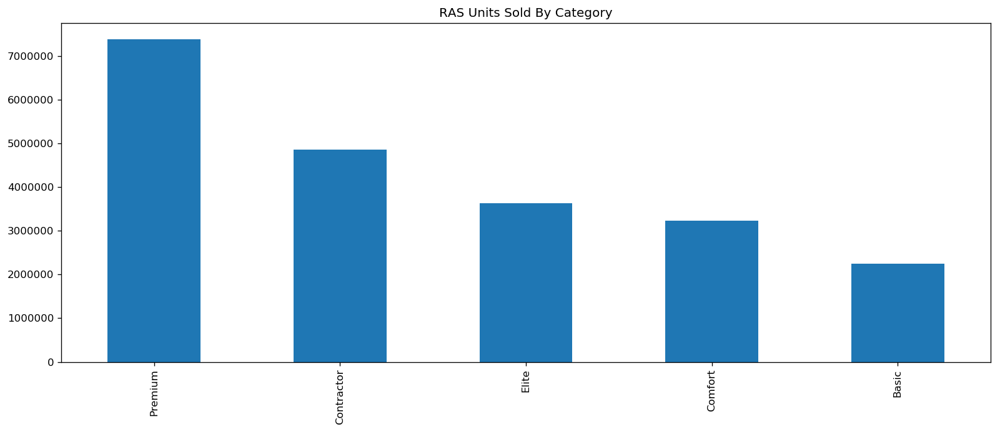

In [23]:
rsums = {}
for k,v in csums.items():
    rsums[k] = v[2018].sum()
rorder = Series(rsums).sort_values(ascending=False)

f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
rorder.plot('bar', ax=ax1, title="RAS Units Sold By Category")

In [24]:
rorder

Premium       7.382e+06
Contractor    4.855e+06
Elite         3.633e+06
Comfort       3.224e+06
Basic         2.249e+06
dtype: float64

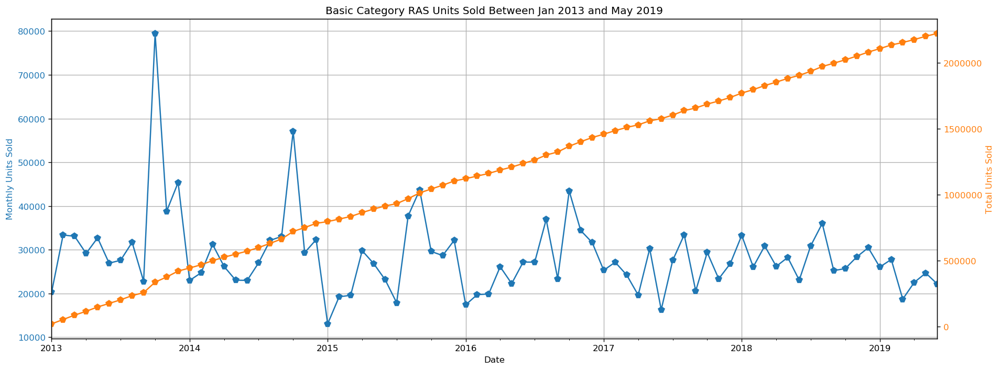

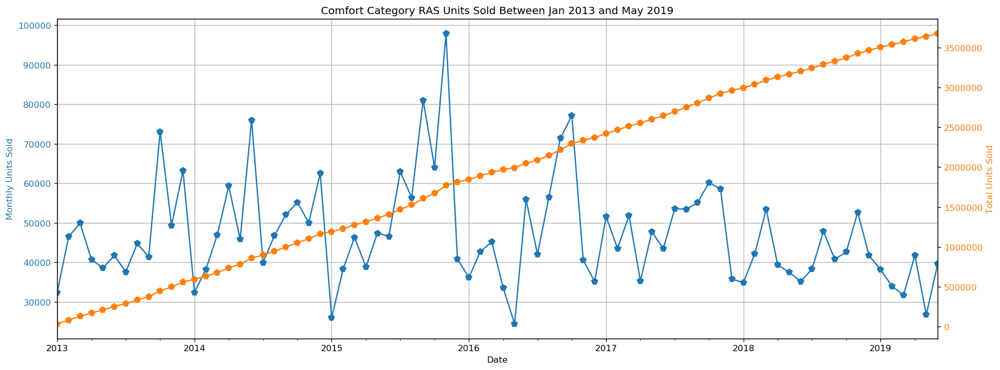

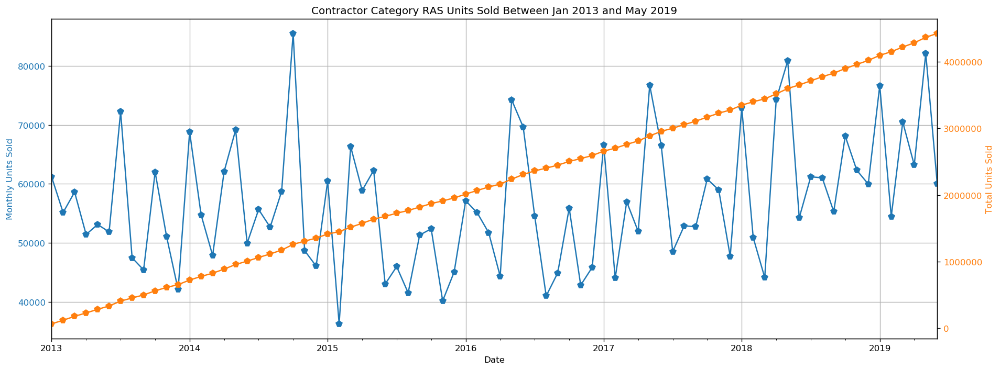

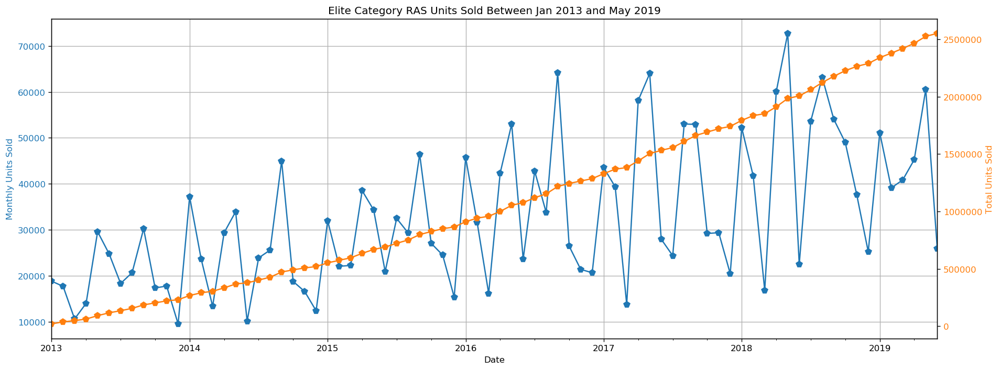

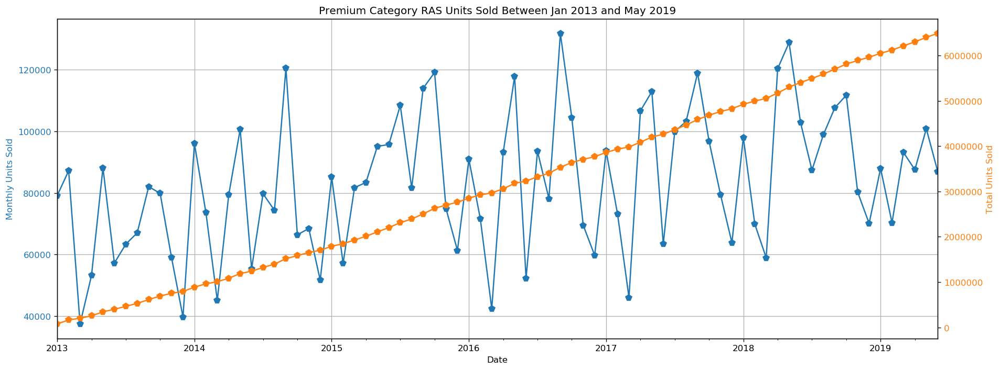

In [25]:
## Monthly Values (Continuous)
for category,localdata in catyearmonthdata.items():
    f, ax1 = plt.subplots(1, 1, figsize=(16,6))
    #plotdata = localdata.sum()
    plotdata = localdata
    color = 'C0'
    ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7, color=color)
    ax1.set_ylabel("Monthly Units Sold", color=color)
    ax1.set_xlabel("Date")
    ax1.tick_params(axis='y', labelcolor=color)    
    ax1.set_title("{0} Category RAS Units Sold Between Jan 2013 and May 2019".format(category))
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    plotdata = localdata.cumsum()
    color = 'C1'
    ax2.set_ylabel('Total Units Sold', color=color)  # we already handled the x-label with ax1
    ax2 = plotdata.plot(ax=ax2, style='-p', ms=7, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    f.tight_layout()  # otherwise the right y-label is slightly clipped  


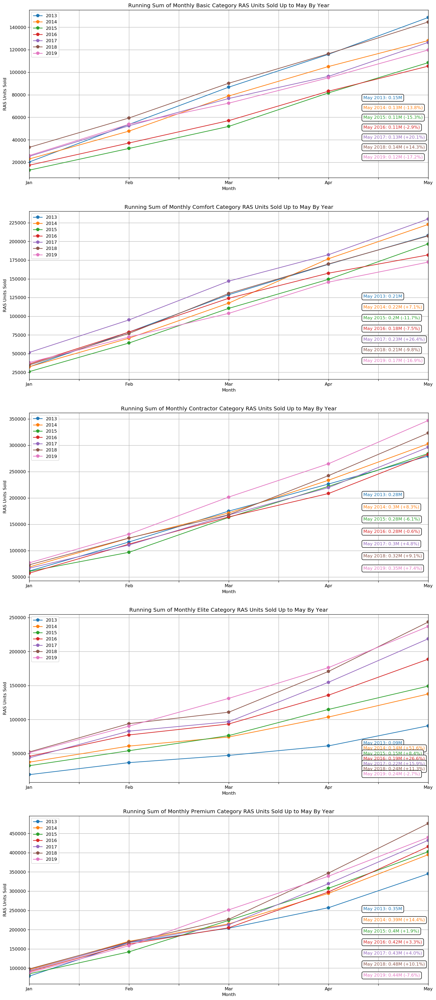

In [26]:
f, axs = plt.subplots(len(csums), 1, sharex=False, sharey=False, figsize=(16,40))

ir = 0
for category,csumdf in csums.items():

    csumdf.index = months
    axs[ir] = csumdf[:5].plot(ax=axs[ir], legend=True, style='-p', ms=7, grid=True)
    axs[ir].set_ylabel("RAS Units Sold")
    axs[ir].set_xlabel("Month")
    axs[ir].set_title("Running Sum of Monthly {0} Category RAS Units Sold Up to May By Year".format(category))
    if True:
        xs = [csumdf[y].iloc[4] for y in years]
        ts = ["May {0}".format(y) for y in years]
        ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
        for i in range(1,len(ts)):
            diff = round(100*(xs[i]/xs[i-1]-1),1)
            if diff > 0:
                ts[i] = "{0} (+{1}%)".format(ts[i], diff)
            else:
                ts[i] = "{0} ({1}%)".format(ts[i], diff)

        ymin = min(xs)
        for i in range(len(xs)):
            axs[ir].text(3.35, (0.75*ymin) - ymin*i/12, ts[i], {'color': "C{0}".format(i), 'fontsize': 10, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")

    ir += 1

In [27]:
#localdata = data.copy()
plotdata = DataFrame(catyearmonthdata)
plotdata.to_pickle("Aggdata/CategorySales.p")

# Regional Sales

In [28]:
regdata = data.copy()
stateNames = [x[-2] for x in regdata.index.str.split(" :: ")]
regdata["region"] = [regionMap[name] for name in stateNames]

regionsales = {}

yeardata = {}
regyearmonthdata = {}
regyeardata = {}
regyearqtrdata = {}
for region,regiondata in regdata.groupby("region"):

    localdata = regiondata.drop(["region"], axis=1)
    localdata = localdata.fillna(0)

    yeardata[region] = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        sums = localyeardata.sum()
        sums.index = [datetime.strftime(x, "%m") for x in sums.index]
        yeardata[region][year] = sums    
    
    regyearmonthdata[region] = localdata.sum()
    regionsales[region] = round(localdata.values.sum(),1)
    

    regyeardata[region] = {}
    regyearqtrdata[region] = {}
    
    rdata = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        localyeardata = localyeardata.fillna(0)
        sales = localyeardata.values.sum()
        rdata["{0}".format(year)] = sales
    regyeardata[region] = rdata
    
csums = {}
for region,rdata in yeardata.items():    
    csumdata = {}
    for k,v in rdata.items():
        csumdata[k] = v.cumsum()
    csumdf = DataFrame(csumdata)
    csums[region] = csumdf

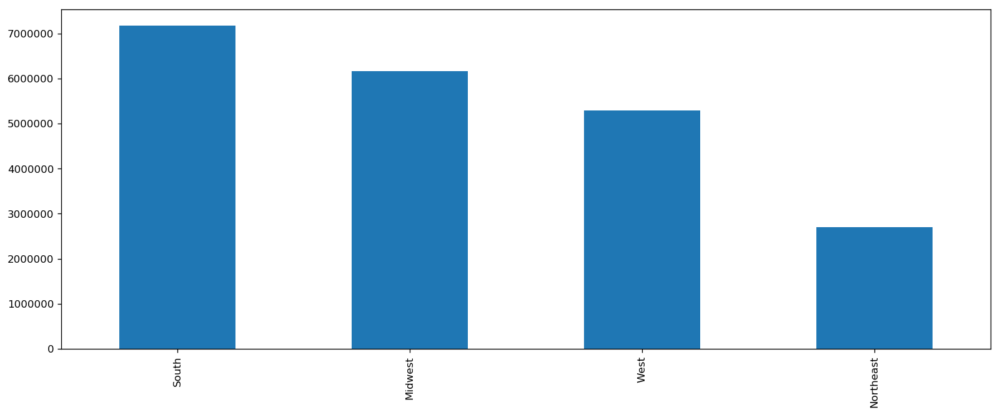

In [29]:
rsums = {}
for k,v in csums.items():
    rsums[k] = v[2018].sum()
rorder = Series(rsums).sort_values(ascending=False)

f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
rorder.plot('bar', ax=ax1)

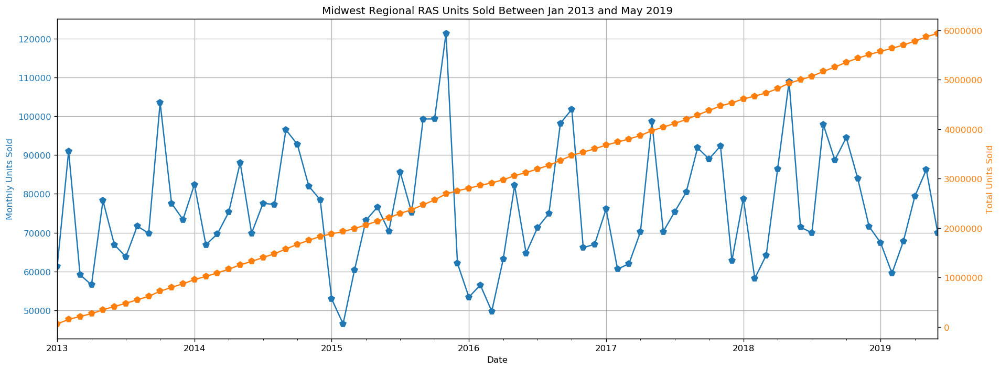

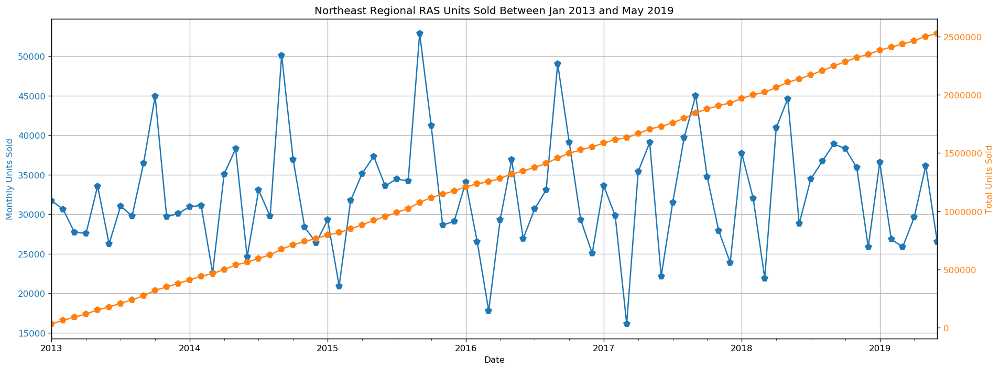

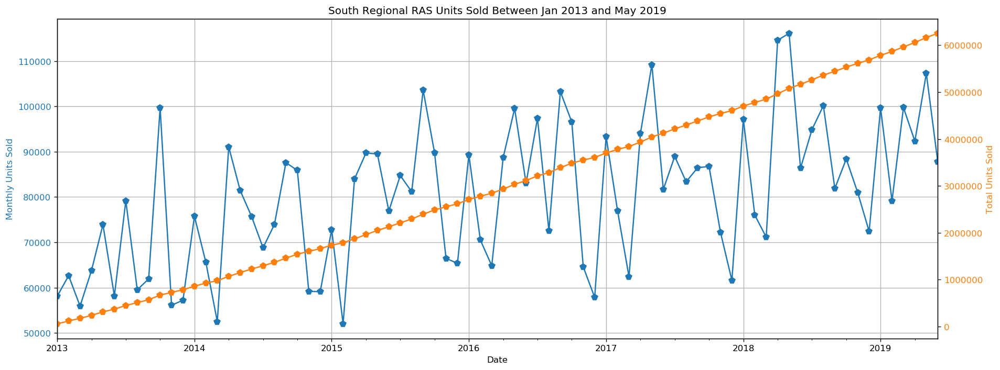

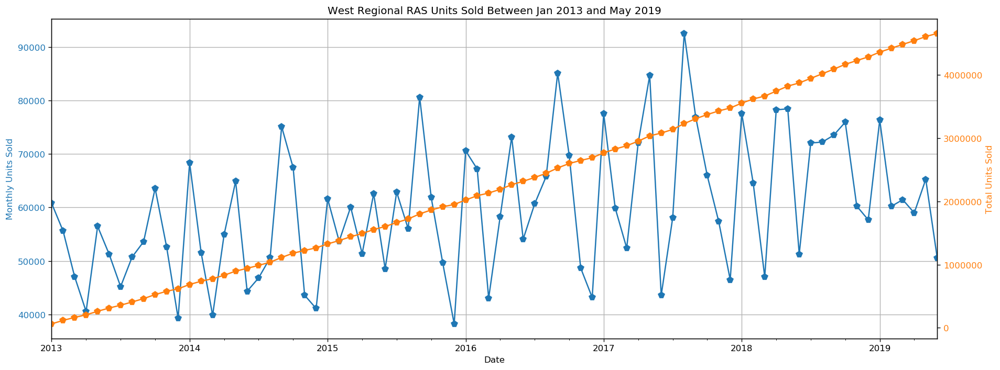

In [30]:
## Monthly Values (Continuous)
for category,localdata in regyearmonthdata.items():
    f, ax1 = plt.subplots(1, 1, figsize=(16,6))
    #plotdata = localdata.sum()
    plotdata = localdata
    color = 'C0'
    ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7, color=color)
    ax1.set_ylabel("Monthly Units Sold", color=color)
    ax1.set_xlabel("Date")
    ax1.tick_params(axis='y', labelcolor=color)    
    ax1.set_title("{0} Regional RAS Units Sold Between Jan 2013 and May 2019".format(category))
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    plotdata = localdata.cumsum()
    color = 'C1'
    ax2.set_ylabel('Total Units Sold', color=color)  # we already handled the x-label with ax1
    ax2 = plotdata.plot(ax=ax2, style='-p', ms=7, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    f.tight_layout()  # otherwise the right y-label is slightly clipped  


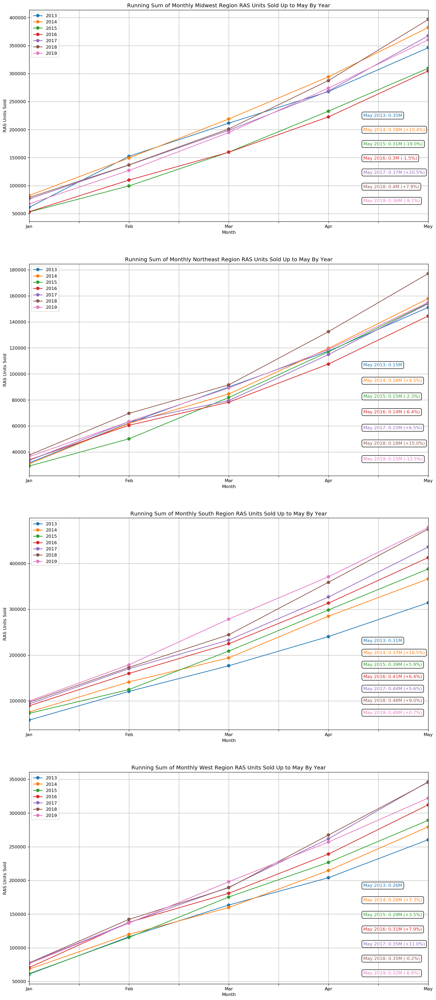

In [31]:
f, axs = plt.subplots(len(csums), 1, sharex=False, sharey=False, figsize=(16,40))

ir = 0
for region,csumdf in csums.items():

    csumdf.index = months
    axs[ir] = csumdf[:5].plot(ax=axs[ir], legend=True, style='-p', ms=7, grid=True)
    axs[ir].set_ylabel("RAS Units Sold")
    axs[ir].set_xlabel("Month")
    axs[ir].set_title("Running Sum of Monthly {0} Region RAS Units Sold Up to May By Year".format(region))
    if True:
        xs = [csumdf[y].iloc[4] for y in years]
        ts = ["May {0}".format(y) for y in years]
        ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
        for i in range(1,len(ts)):
            diff = round(100*(xs[i]/xs[i-1]-1),1)
            if diff > 0:
                ts[i] = "{0} (+{1}%)".format(ts[i], diff)
            else:
                ts[i] = "{0} ({1}%)".format(ts[i], diff)

        ymin = min(xs)
        for i in range(len(xs)):
            axs[ir].text(3.35, (0.75*ymin) - ymin*i/12, ts[i], {'color': "C{0}".format(i), 'fontsize': 10, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")

    ir += 1

In [32]:
plotdata = DataFrame(regyearmonthdata)
plotdata.to_pickle("Aggdata/RegionalSales.p")

# Divisional Sales

In [33]:
regdata = data.copy()
stateNames = [x[-2] for x in regdata.index.str.split(" :: ")]
regdata["division"] = [divisionMap[name] for name in stateNames]

regionsales = {}

yeardata = {}
regyearmonthdata = {}
regyeardata = {}
regyearqtrdata = {}
for region,regiondata in regdata.groupby("division"):
    
    if region in ["Latin", "Canada"]:
        continue

    localdata = regiondata.drop(["division"], axis=1)
    localdata = localdata.fillna(0)

    yeardata[region] = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        sums = localyeardata.sum()
        sums.index = [datetime.strftime(x, "%m") for x in sums.index]
        yeardata[region][year] = sums    
    
    regyearmonthdata[region] = localdata.sum()
    regionsales[region] = round(localdata.values.sum(),1)
    

    regyeardata[region] = {}
    regyearqtrdata[region] = {}
    
    rdata = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        localyeardata = localyeardata.fillna(0)
        sales = localyeardata.values.sum()
        rdata["{0}".format(year)] = sales
    regyeardata[region] = rdata
    
csums = {}
for region,rdata in yeardata.items():    
    csumdata = {}
    for k,v in rdata.items():
        csumdata[k] = v.cumsum()
    csumdf = DataFrame(csumdata)
    csums[region] = csumdf

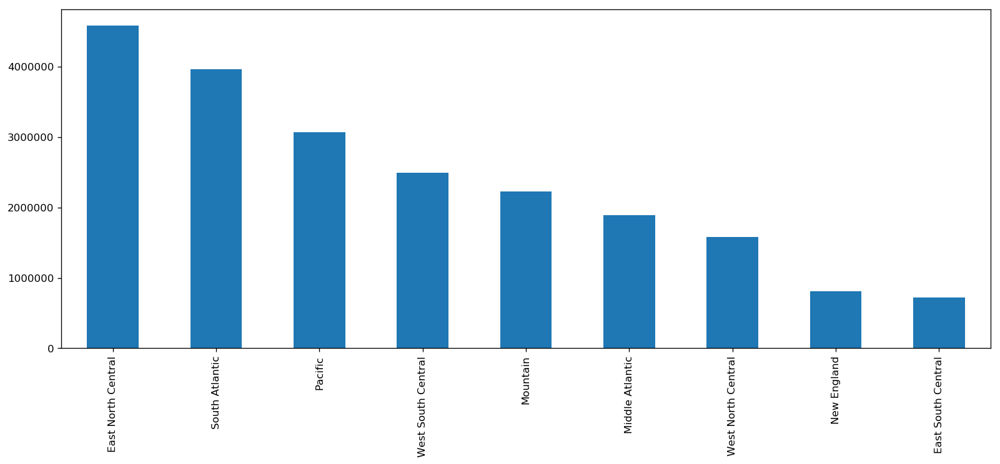

In [34]:
rsums = {}
for k,v in csums.items():
    rsums[k] = v[2018].sum()
rorder = Series(rsums).sort_values(ascending=False)

f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
rorder.plot('bar', ax=ax1)

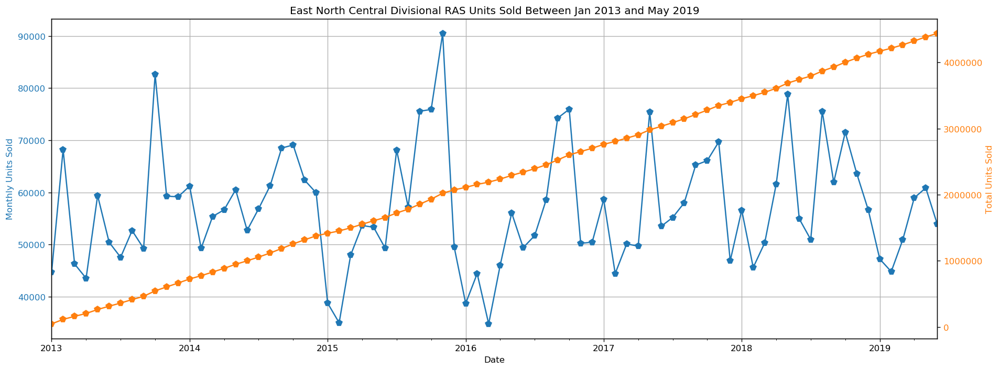

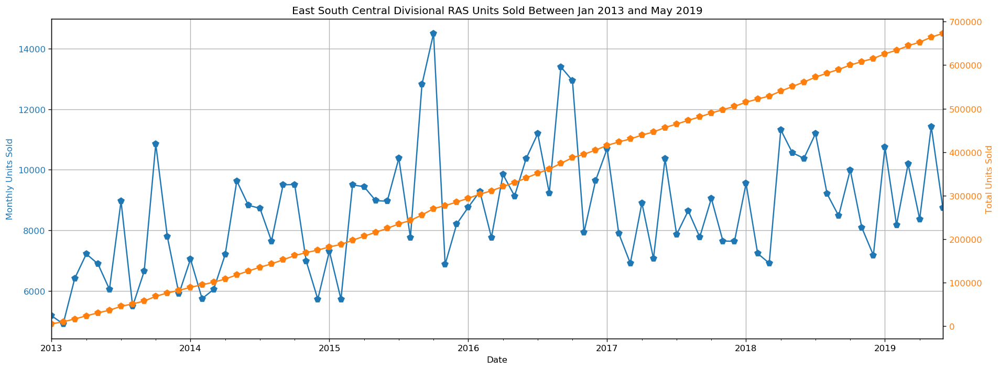

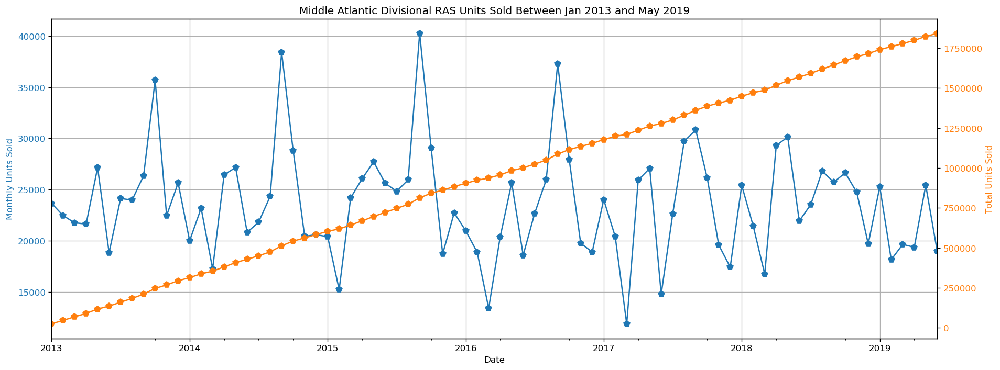

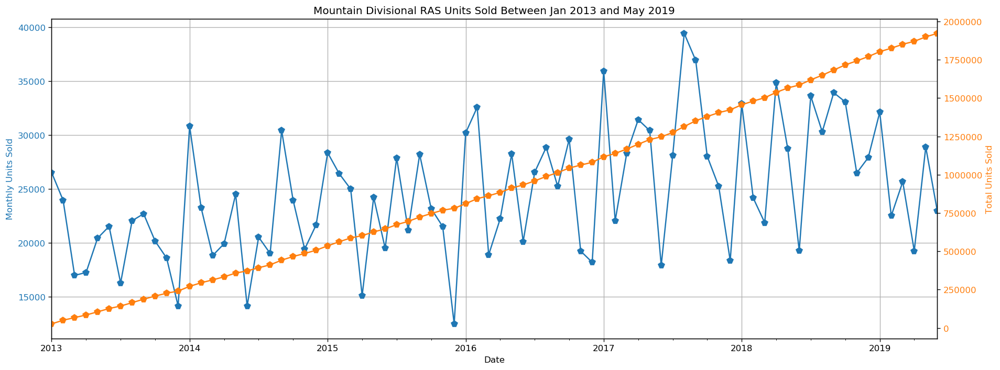

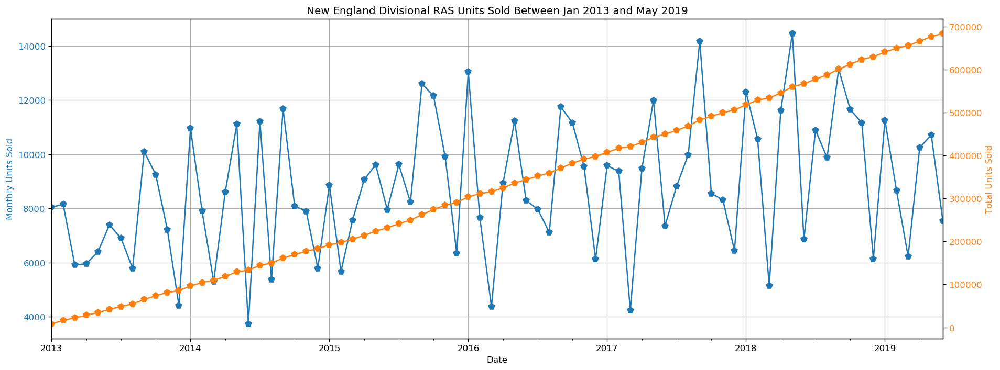

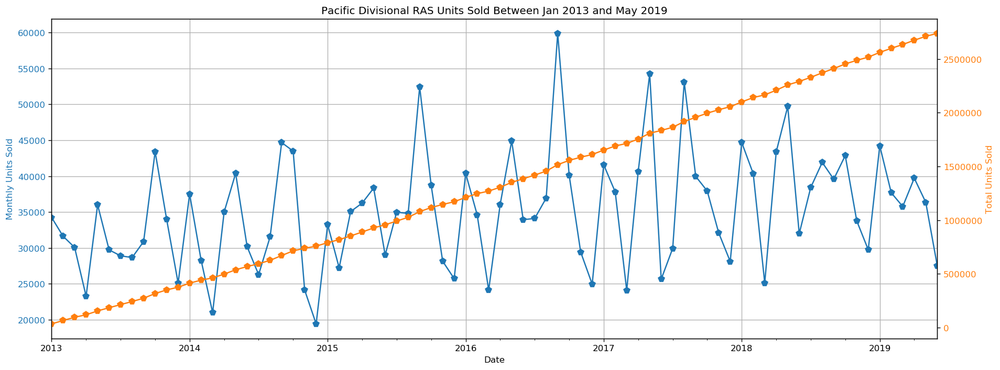

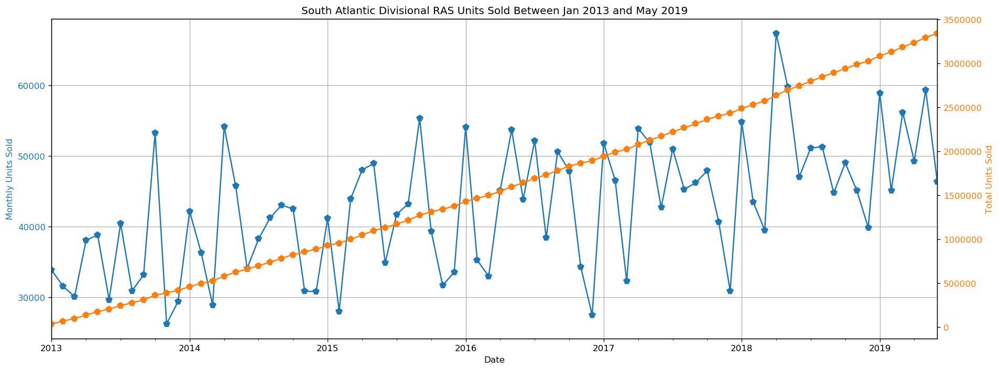

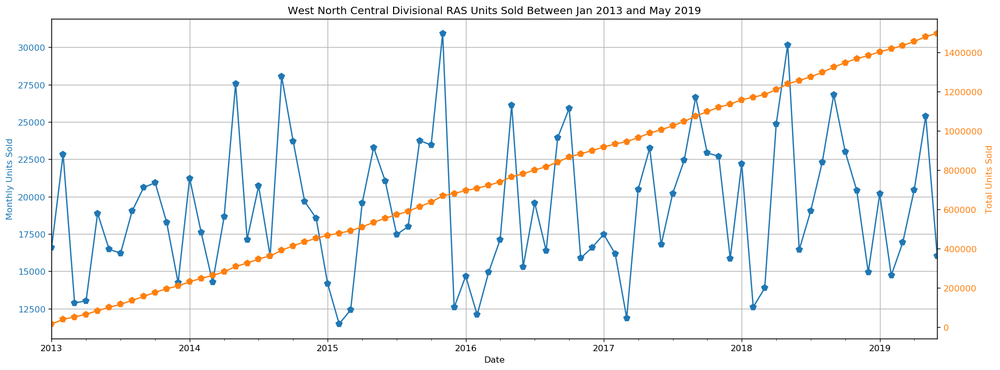

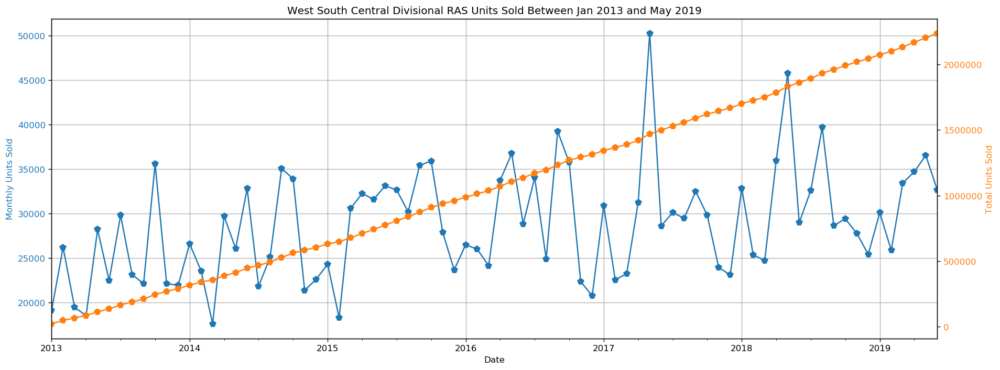

In [35]:
## Monthly Values (Continuous)
for category,localdata in regyearmonthdata.items():
    f, ax1 = plt.subplots(1, 1, figsize=(16,6))
    #plotdata = localdata.sum()
    plotdata = localdata
    color = 'C0'
    ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7, color=color)
    ax1.set_ylabel("Monthly Units Sold", color=color)
    ax1.set_xlabel("Date")
    ax1.tick_params(axis='y', labelcolor=color)    
    ax1.set_title("{0} Divisional RAS Units Sold Between Jan 2013 and May 2019".format(category))
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    plotdata = localdata.cumsum()
    color = 'C1'
    ax2.set_ylabel('Total Units Sold', color=color)  # we already handled the x-label with ax1
    ax2 = plotdata.plot(ax=ax2, style='-p', ms=7, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    f.tight_layout()  # otherwise the right y-label is slightly clipped  


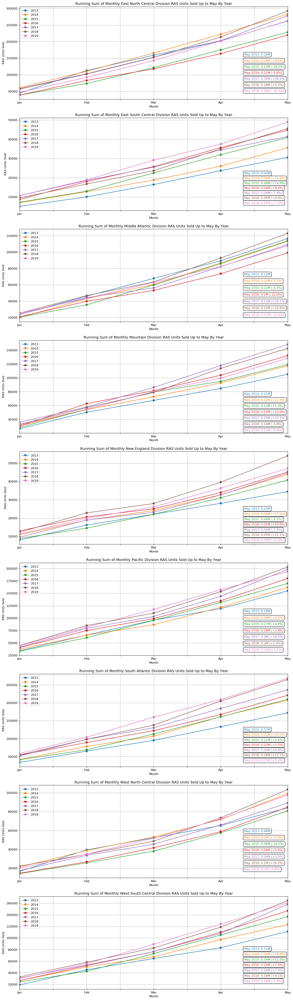

In [36]:
f, axs = plt.subplots(len(csums), 1, sharex=False, sharey=False, figsize=(16,60))

ir = 0
for category,csumdf in csums.items():

    csumdf.index = months
    axs[ir] = csumdf[:5].plot(ax=axs[ir], legend=True, style='-p', ms=7, grid=True)
    axs[ir].set_ylabel("RAS Units Sold")
    axs[ir].set_xlabel("Month")
    axs[ir].set_title("Running Sum of Monthly {0} Division RAS Units Sold Up to May By Year".format(category))
    if True:
        xs = [csumdf[y].iloc[4] for y in years]
        ts = ["May {0}".format(y) for y in years]
        ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
        for i in range(1,len(ts)):
            diff = round(100*(xs[i]/xs[i-1]-1),1)
            if diff > 0:
                ts[i] = "{0} (+{1}%)".format(ts[i], diff)
            else:
                ts[i] = "{0} ({1}%)".format(ts[i], diff)

        ymin = min(xs)
        for i in range(len(xs)):
            axs[ir].text(3.35, (0.75*ymin) - ymin*i/12, ts[i], {'color': "C{0}".format(i), 'fontsize': 10, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")

    ir += 1

In [37]:
plotdata = DataFrame(regyearmonthdata)
plotdata.to_pickle("Aggdata/DivisionalSales.p")

# Profit Center Sales

In [38]:
pcdata = data.copy()
pcdata["profit"] = [x[0] for x in data.index.str.split(" :: ")]

profitsales = {}

yeardata = {}
pcyearmonthdata = {}
pcyeardata = {}
pcyearqtrdata = {}
for profit,profitdata in pcdata.groupby("profit"):

    localdata = profitdata.drop(["profit"], axis=1)
    localdata = localdata.fillna(0)

    yeardata[profit] = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        sums = localyeardata.sum()
        sums.index = [datetime.strftime(x, "%m") for x in sums.index]
        yeardata[profit][year] = sums    
    
    pcyearmonthdata[profit] = localdata.sum()
    profitsales[profit] = round(localdata.values.sum(),1)
    

    pcyeardata[profit] = {}
    pcyearqtrdata[profit] = {}
    
    rdata = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        localyeardata = localyeardata.fillna(0)
        sales = localyeardata.values.sum()
        rdata["{0}".format(year)] = sales
    pcyeardata[profit] = rdata
    
csums = {}
for region,rdata in yeardata.items():    
    csumdata = {}
    for k,v in rdata.items():
        csumdata[k] = v.cumsum()
    csumdf = DataFrame(csumdata)
    csums[region] = csumdf

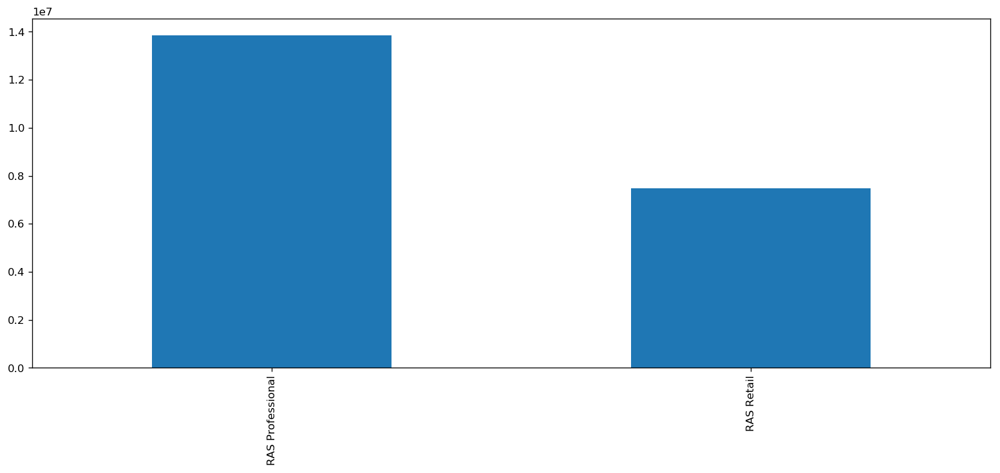

In [39]:
rsums = {}
for k,v in csums.items():
    rsums[k] = v[2018].sum()
rorder = Series(rsums).sort_values(ascending=False)

f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
rorder.plot('bar', ax=ax1)

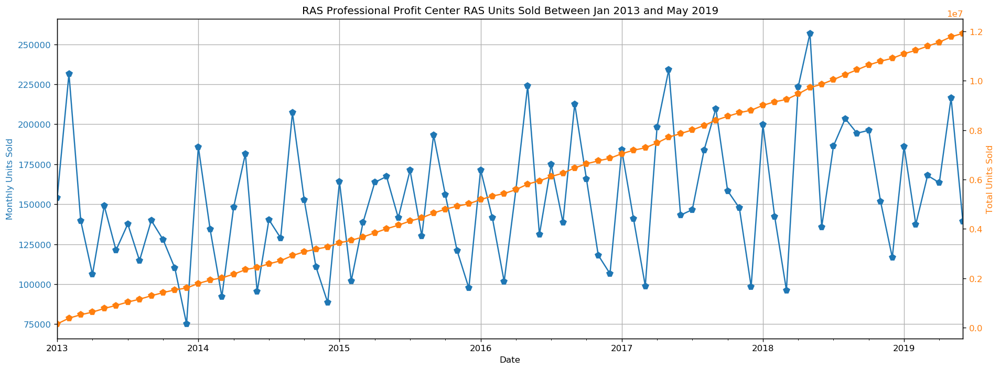

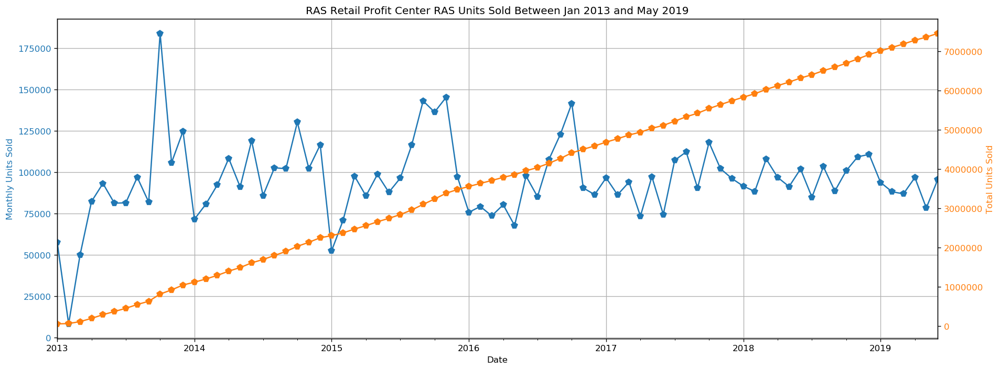

In [40]:
## Monthly Values (Continuous)
for category,localdata in pcyearmonthdata.items():
    f, ax1 = plt.subplots(1, 1, figsize=(16,6))
    #plotdata = localdata.sum()
    plotdata = localdata
    color = 'C0'
    ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7, color=color)
    ax1.set_ylabel("Monthly Units Sold", color=color)
    ax1.set_xlabel("Date")
    ax1.tick_params(axis='y', labelcolor=color)    
    ax1.set_title("{0} Profit Center RAS Units Sold Between Jan 2013 and May 2019".format(category))
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    plotdata = localdata.cumsum()
    color = 'C1'
    ax2.set_ylabel('Total Units Sold', color=color)  # we already handled the x-label with ax1
    ax2 = plotdata.plot(ax=ax2, style='-p', ms=7, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    f.tight_layout()  # otherwise the right y-label is slightly clipped  


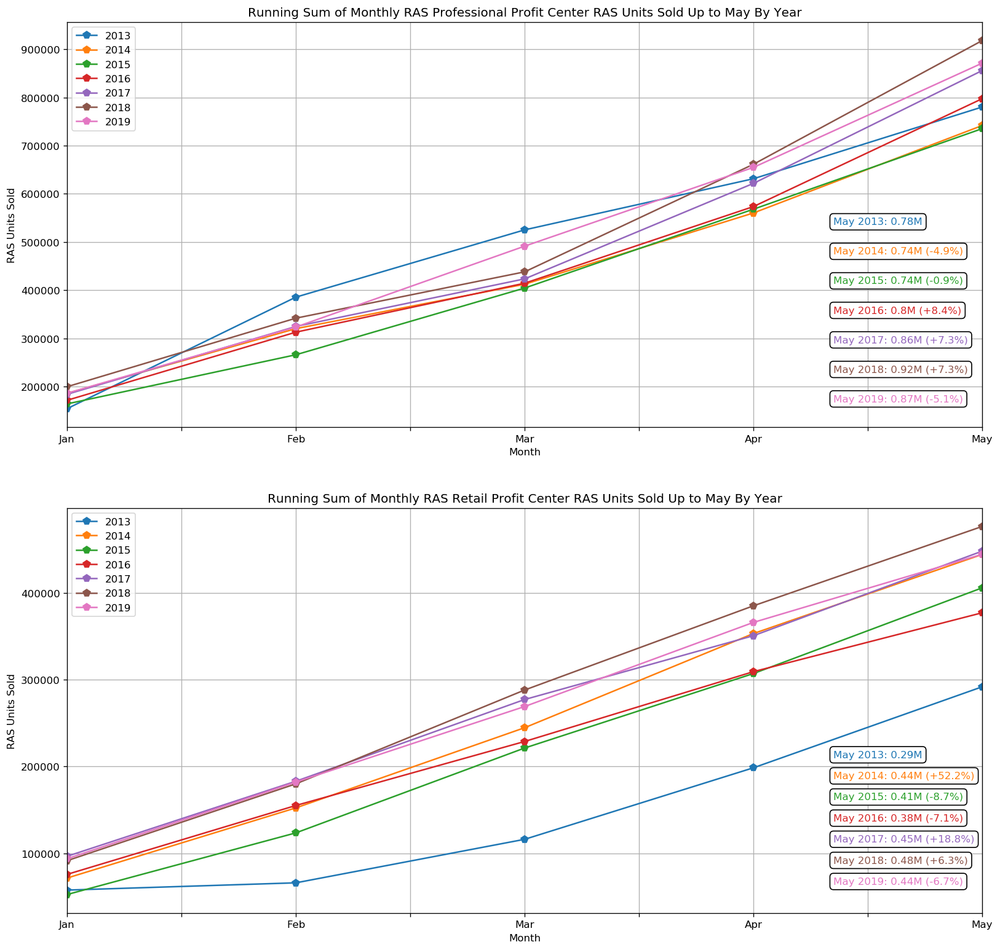

In [41]:
f, axs = plt.subplots(len(csums), 1, sharex=False, sharey=False, figsize=(16,16))

ir = 0
for category,csumdf in csums.items():

    csumdf.index = months
    axs[ir] = csumdf[:5].plot(ax=axs[ir], legend=True, style='-p', ms=7, grid=True)
    axs[ir].set_ylabel("RAS Units Sold")
    axs[ir].set_xlabel("Month")
    axs[ir].set_title("Running Sum of Monthly {0} Profit Center RAS Units Sold Up to May By Year".format(category))
    if True:
        xs = [csumdf[y].iloc[4] for y in years]
        ts = ["May {0}".format(y) for y in years]
        ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
        for i in range(1,len(ts)):
            diff = round(100*(xs[i]/xs[i-1]-1),1)
            if diff > 0:
                ts[i] = "{0} (+{1}%)".format(ts[i], diff)
            else:
                ts[i] = "{0} ({1}%)".format(ts[i], diff)

        ymin = min(xs)
        for i in range(len(xs)):
            axs[ir].text(3.35, (0.75*ymin) - ymin*i/12, ts[i], {'color': "C{0}".format(i), 'fontsize': 10, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")

    ir += 1

In [42]:
plotdata = DataFrame(pcyearmonthdata)
plotdata.to_pickle("Aggdata/ProfitCenterSales.p")

# Profit Center / Category Sales

In [43]:
pccatdata = data.copy()
pccatdata["profit"] = [x[0] for x in pccatdata.index.str.split(" :: ")]
pccatdata["category"] = [x[-1] for x in pccatdata.index.str.split(" :: ")]
cols = pccatdata.columns[-2:]
pccatdata["profitcategory"] = pccatdata[cols].apply(lambda x: ' - '.join(str(y) for y in x), axis=1)
pccatdata = pccatdata.drop(["profit", "category"], axis=1)
pccatdata.head()

profitcategorysales = {}

yeardata = {}
pccatyearmonthdata = {}
pccatyeardata = {}
pccatyearqtrdata = {}
for profitcategory,profitcategorydata in pccatdata.groupby("profitcategory"):

    if profitcategory in ['RAS Retail - Elite', 'RAS Professional - Comfort', 'RAS Professional - Basic']:
        continue
        
    localdata = profitcategorydata.drop(["profitcategory"], axis=1)
    localdata = localdata.fillna(0)

    yeardata[profitcategory] = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        sums = localyeardata.sum()
        sums.index = [datetime.strftime(x, "%m") for x in sums.index]
        yeardata[profitcategory][year] = sums    
    
    pccatyearmonthdata[profitcategory] = localdata.sum()
    profitcategorysales[profitcategory] = round(localdata.values.sum(),1)
    

    pccatyeardata[profitcategory] = {}
    pccatyearqtrdata[profitcategory] = {}
    
    rdata = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        localyeardata = localyeardata.fillna(0)
        sales = localyeardata.values.sum()
        rdata["{0}".format(year)] = sales
    pccatyeardata[profitcategory] = rdata
    
csums = {}
for region,rdata in yeardata.items():    
    csumdata = {}
    for k,v in rdata.items():
        csumdata[k] = v.cumsum()
    csumdf = DataFrame(csumdata)
    csums[region] = csumdf

[]


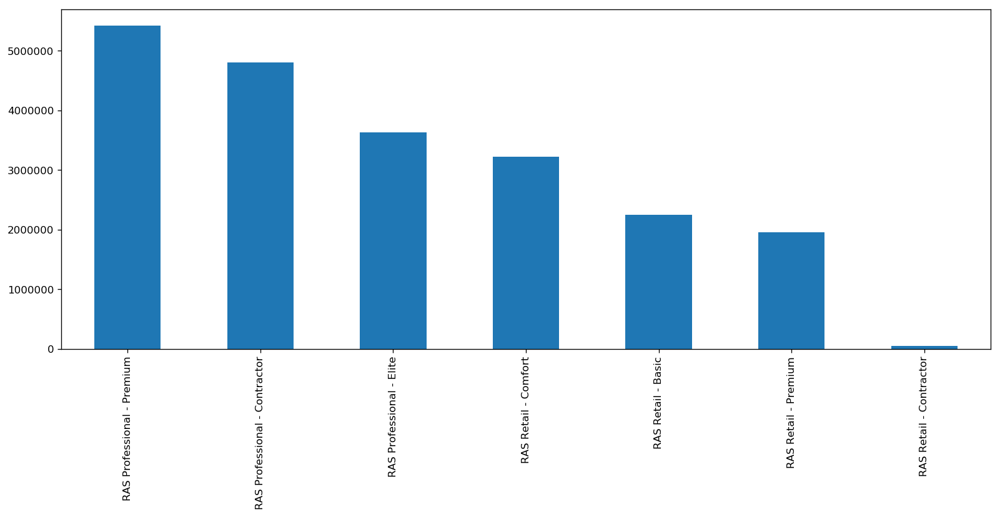

In [44]:
rsums = {}
for k,v in csums.items():
    rsums[k] = v[2018].sum()
rorder = Series(rsums).sort_values(ascending=False)

f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
print(list(rorder[rorder <= 0.0].index))
rorder.plot('bar', ax=ax1)

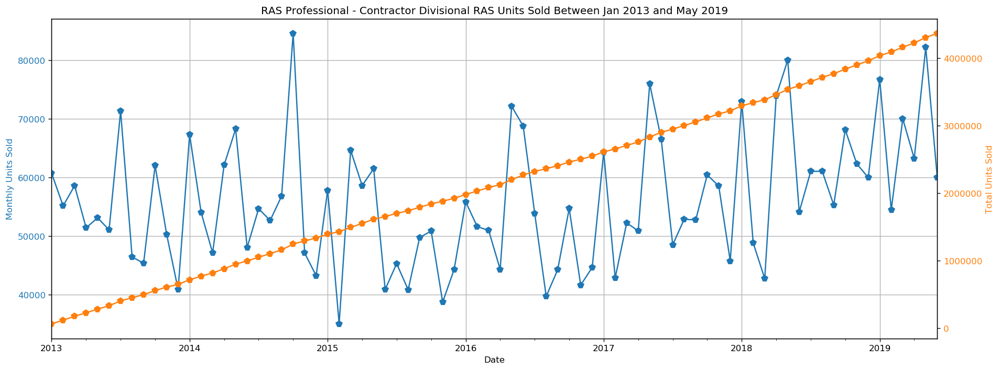

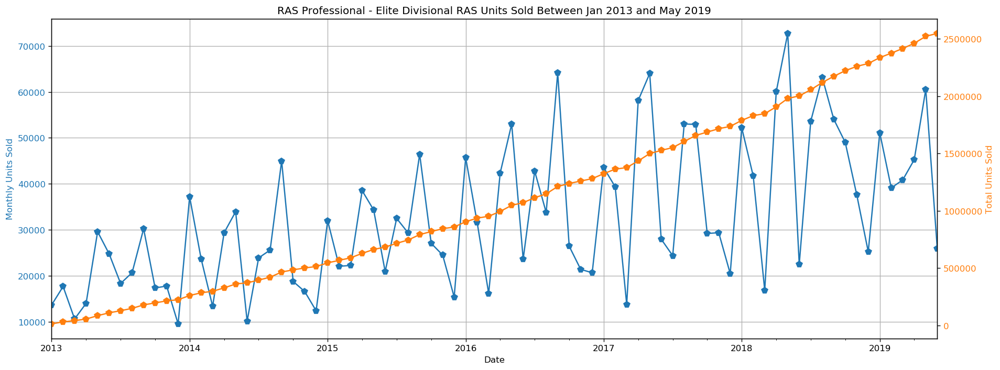

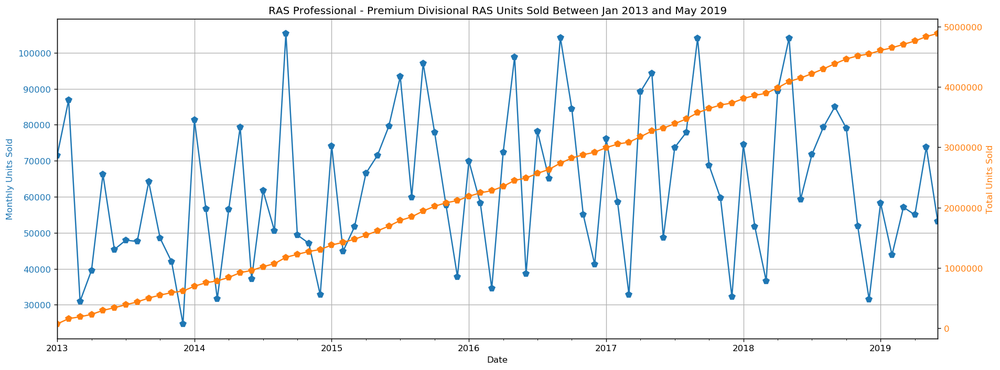

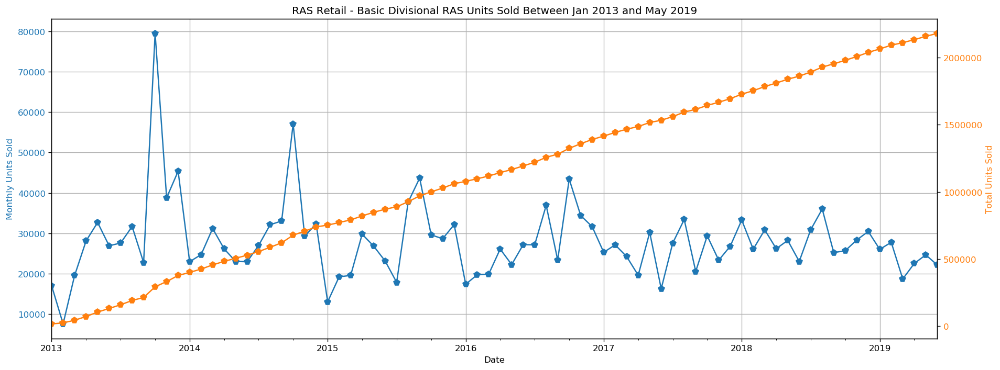

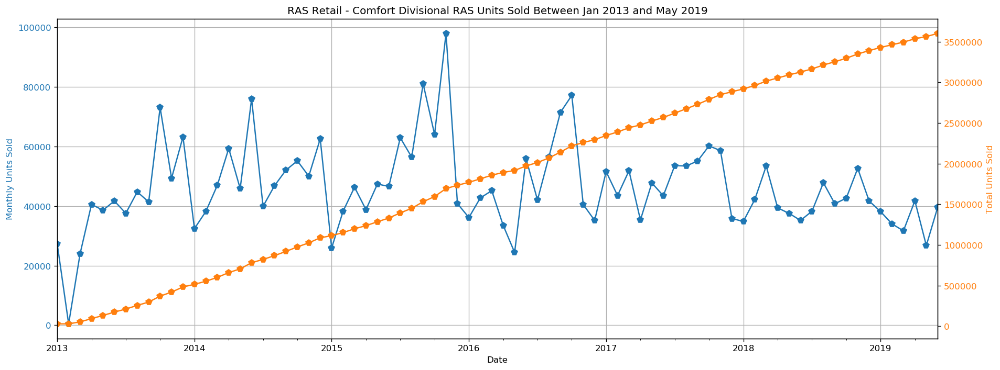

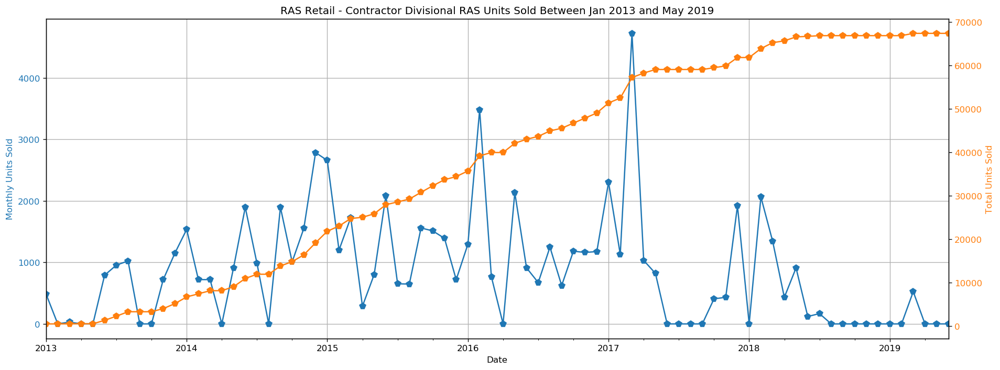

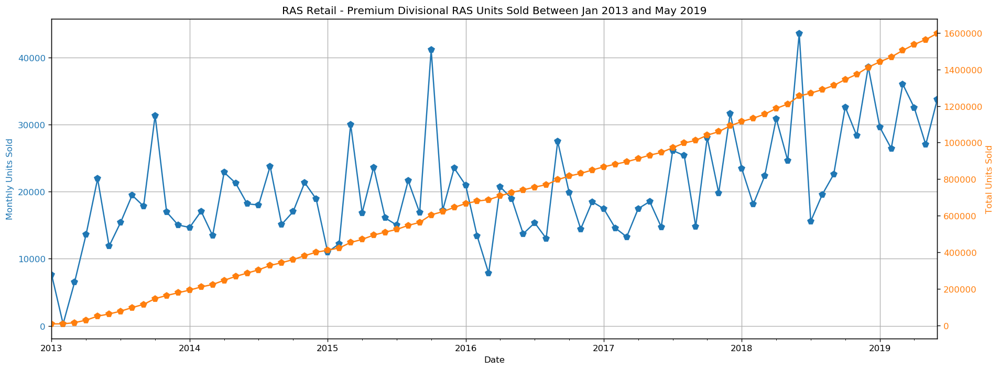

In [45]:
## Monthly Values (Continuous)
for category,localdata in pccatyearmonthdata.items():
    f, ax1 = plt.subplots(1, 1, figsize=(16,6))
    #plotdata = localdata.sum()
    plotdata = localdata
    color = 'C0'
    ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7, color=color)
    ax1.set_ylabel("Monthly Units Sold", color=color)
    ax1.set_xlabel("Date")
    ax1.tick_params(axis='y', labelcolor=color)    
    ax1.set_title("{0} Divisional RAS Units Sold Between Jan 2013 and May 2019".format(category))
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    plotdata = localdata.cumsum()
    color = 'C1'
    ax2.set_ylabel('Total Units Sold', color=color)  # we already handled the x-label with ax1
    ax2 = plotdata.plot(ax=ax2, style='-p', ms=7, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    f.tight_layout()  # otherwise the right y-label is slightly clipped  


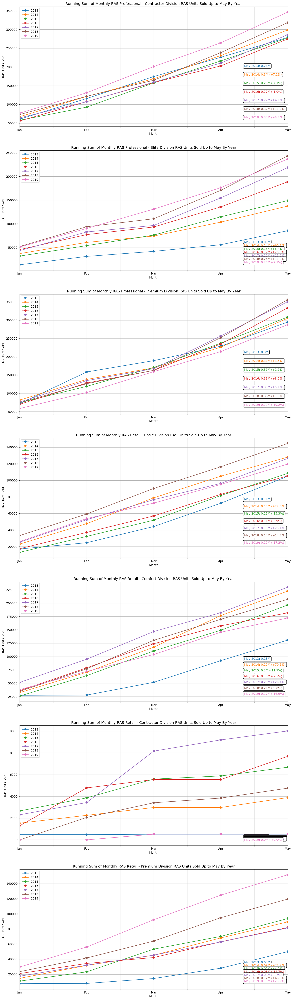

In [46]:
f, axs = plt.subplots(len(csums), 1, sharex=False, sharey=False, figsize=(16,60))

ir = 0
for category,csumdf in csums.items():

    csumdf.index = months
    axs[ir] = csumdf[:5].plot(ax=axs[ir], legend=True, style='-p', ms=7, grid=True)
    axs[ir].set_ylabel("RAS Units Sold")
    axs[ir].set_xlabel("Month")
    axs[ir].set_title("Running Sum of Monthly {0} Division RAS Units Sold Up to May By Year".format(category))
    if True:
        xs = [csumdf[y].iloc[4] for y in years]
        ts = ["May {0}".format(y) for y in years]
        ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
        for i in range(1,len(ts)):
            diff = round(100*(xs[i]/xs[i-1]-1),1)
            if diff > 0:
                ts[i] = "{0} (+{1}%)".format(ts[i], diff)
            else:
                ts[i] = "{0} ({1}%)".format(ts[i], diff)

        ymin = min(xs)
        for i in range(len(xs)):
            axs[ir].text(3.35, (0.75*ymin) - ymin*i/12, ts[i], {'color': "C{0}".format(i), 'fontsize': 10, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")

    ir += 1

In [47]:
plotdata = DataFrame(pccatyearmonthdata)
plotdata.to_pickle("Aggdata/ProfitCenterCategorySales.p")

In [48]:
plotdata

,RAS Professional - Contractor,RAS Professional - Elite,RAS Professional - Premium,RAS Retail - Basic,RAS Retail - Comfort,RAS Retail - Contractor,RAS Retail - Premium
2013-01-01,60713.0,13651.0,71517.0,17064.0,27368.0,486.0,7633.0
2013-02-01,55154.0,17662.0,86883.0,7594.0,453.0,0.0,286.0
2013-03-01,58583.0,10613.0,30993.0,19572.0,23976.0,30.0,6518.0
2013-04-01,51428.0,14004.0,39571.0,28140.0,40552.0,0.0,13637.0
2013-05-01,53119.0,29586.0,66213.0,32699.0,38604.0,0.0,21946.0
2013-06-01,51078.0,24776.0,45366.0,26934.0,41708.0,792.0,11884.0
2013-07-01,71319.0,18325.0,47953.0,27601.0,37574.0,956.0,15425.0
2013-08-01,46446.0,20681.0,47591.0,31694.0,44770.0,1023.0,19479.0
2013-09-01,45414.0,30224.0,64177.0,22771.0,41383.0,0.0,17845.0
2013-10-01,62026.0,17350.0,48494.0,79486.0,73072.0,0.0,31389.0


# Profit Center / Category / Region Sales

In [49]:
pccatregdata = data.copy()
pccatregdata["profit"]   = [x[0] for x in pccatregdata.index.str.split(" :: ")]
pccatregdata["category"] = [x[-1] for x in pccatregdata.index.str.split(" :: ")]
stateNames = [x[-2] for x in regdata.index.str.split(" :: ")]
pccatregdata["region"] = [regionMap[name] for name in stateNames]
cols = pccatregdata.columns[-3:]
pccatregdata["profitcategoryregion"] = pccatregdata[cols].apply(lambda x: ' - '.join(str(y) for y in x), axis=1)
pccatregdata = pccatregdata.drop(["profit", "category", "region"], axis=1)

profitcategoryregionsales = {}

yeardata = {}
pccatregyearmonthdata = {}
pccatregyeardata = {}
pccatregyearqtrdata = {}
for profitcategoryregion,profitcategoryregiondata in pccatregdata.groupby("profitcategoryregion"):

    if profitcategoryregion in ['RAS Retail - Elite - Midwest', 'RAS Retail - Elite - Northeast', 'RAS Retail - Elite - South', 'RAS Retail - Elite - West', 'RAS Retail - Contractor - South', 'RAS Professional - Comfort - West', 'RAS Professional - Comfort - South', 'RAS Professional - Comfort - Northeast', 'RAS Professional - Comfort - Midwest', 'RAS Professional - Basic - West', 'RAS Professional - Basic - South', 'RAS Professional - Basic - Northeast', 'RAS Professional - Basic - Midwest']:
        continue
    
    localdata = profitcategoryregiondata.drop(["profitcategoryregion"], axis=1)
    localdata = localdata.fillna(0)

    yeardata[profitcategoryregion] = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        sums = localyeardata.sum()
        sums.index = [datetime.strftime(x, "%m") for x in sums.index]
        yeardata[profitcategoryregion][year] = sums    
    
    pccatregyearmonthdata[profitcategoryregion] = localdata.sum()
    profitcategoryregionsales[profitcategoryregion] = round(localdata.values.sum(),1)
    

    pccatregyeardata[profitcategoryregion] = {}
    pccatregyearqtrdata[profitcategoryregion] = {}
    
    rdata = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        localyeardata = localyeardata.fillna(0)
        sales = localyeardata.values.sum()
        rdata["{0}".format(year)] = sales
    pccatregyeardata[profitcategoryregion] = rdata
    
csums = {}
for region,rdata in yeardata.items():    
    csumdata = {}
    for k,v in rdata.items():
        csumdata[k] = v.cumsum()
    csumdf = DataFrame(csumdata)
    csums[region] = csumdf

[]


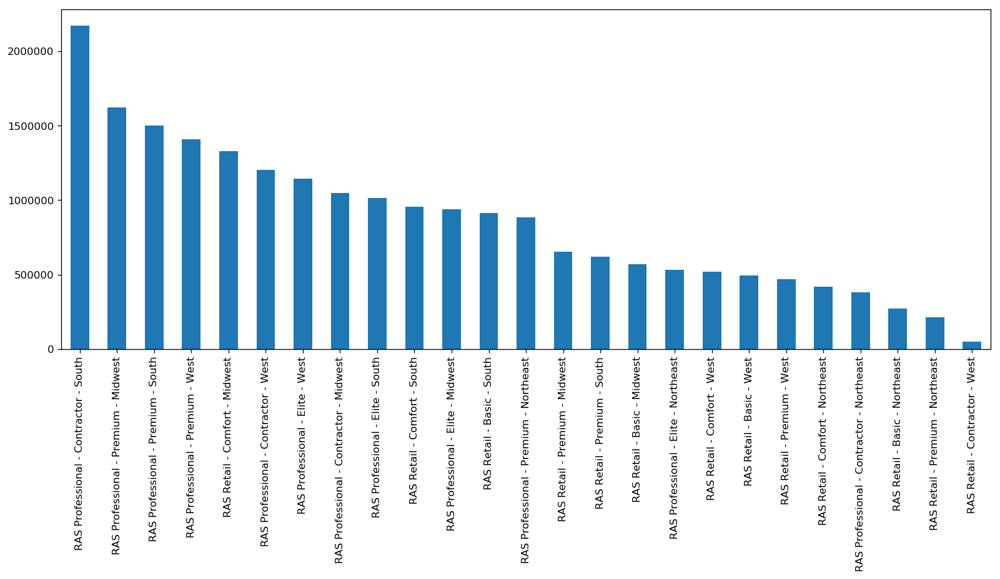

In [50]:
rsums = {}
for k,v in csums.items():
    rsums[k] = v[2018].sum()
rorder = Series(rsums).sort_values(ascending=False)

f, (ax1) = plt.subplots(1, 1, figsize=(16,6))

print(list(rorder[rorder <= 0.0].index))
rorder.plot('bar', ax=ax1)

/anaconda3/envs/py37/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


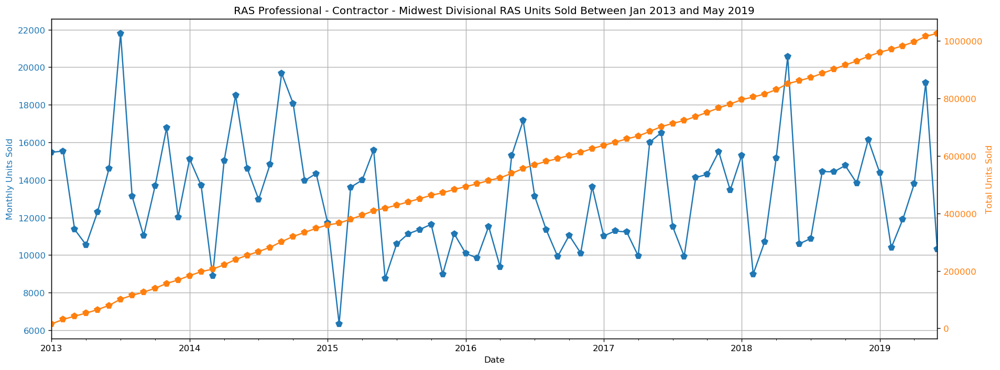

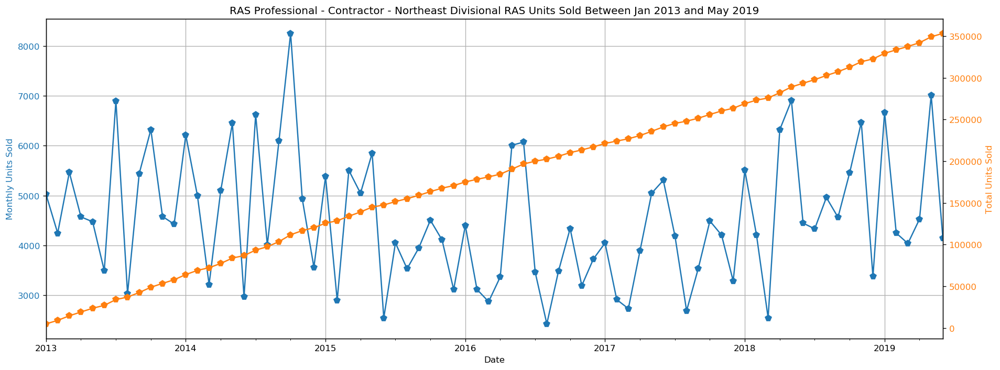

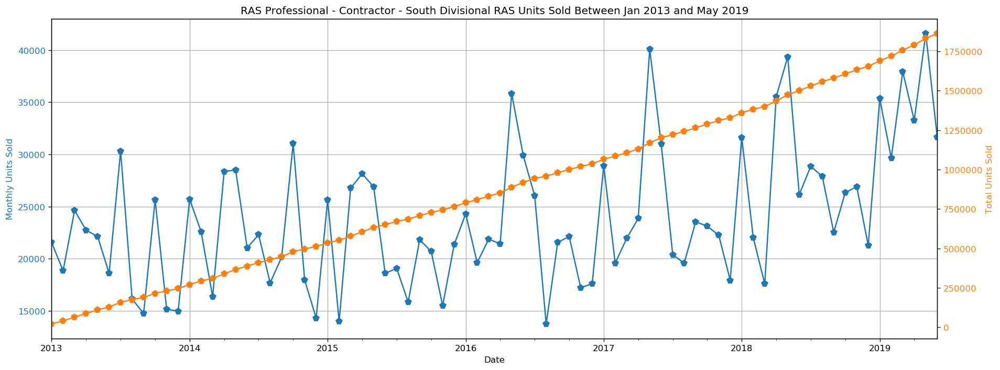

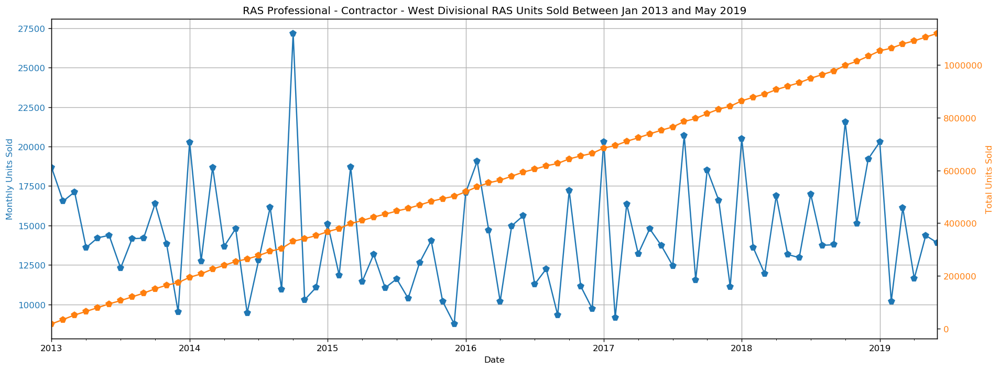

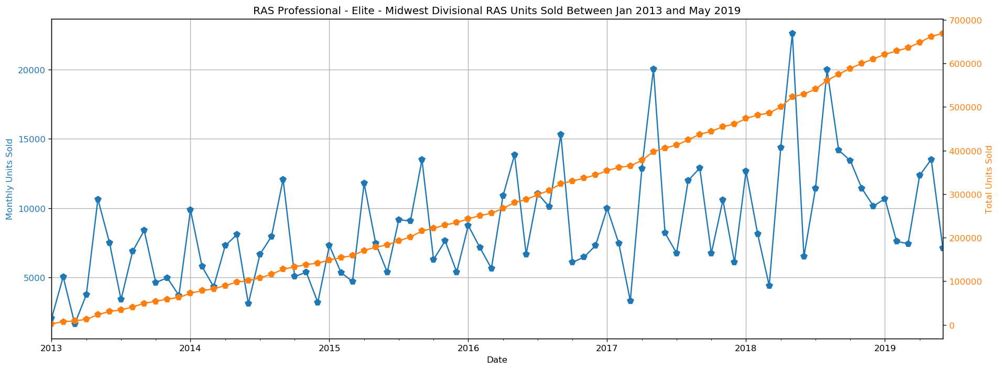

...

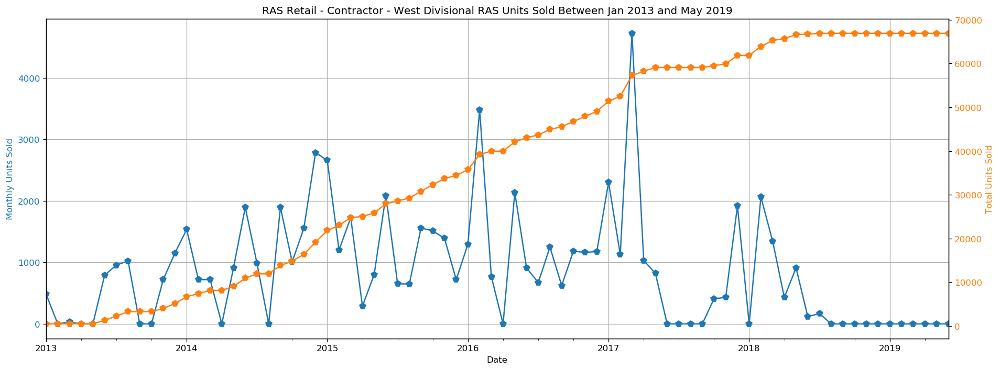

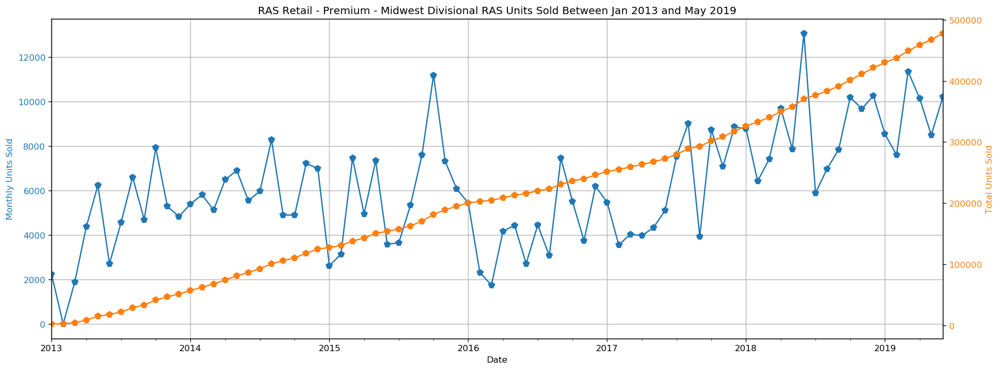

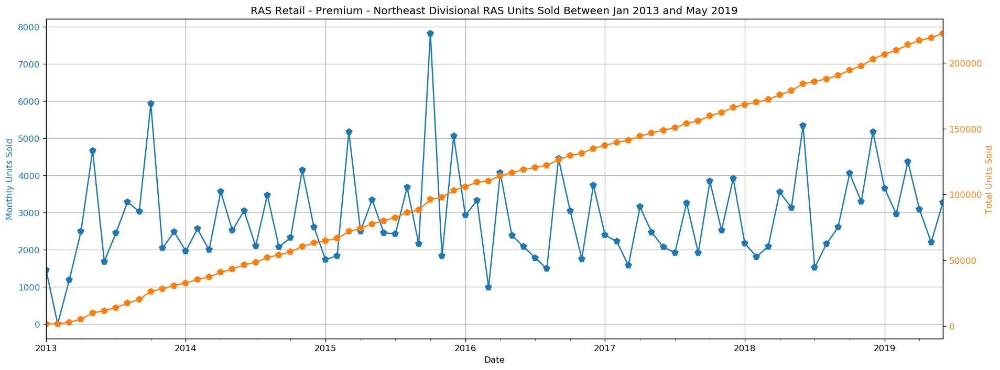

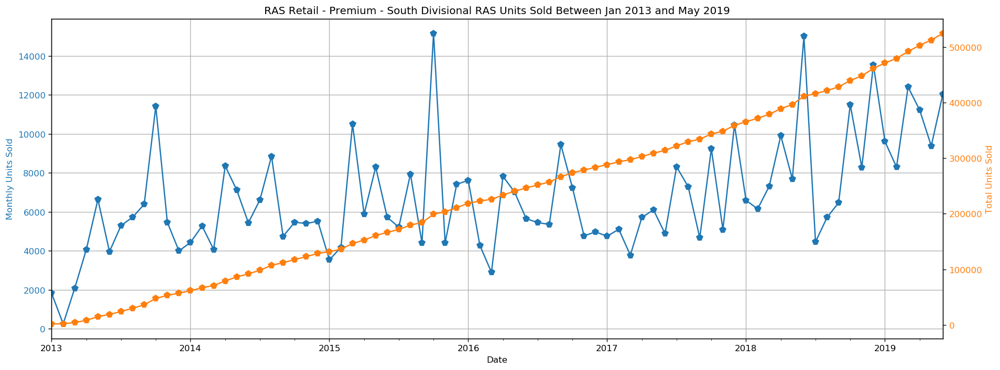

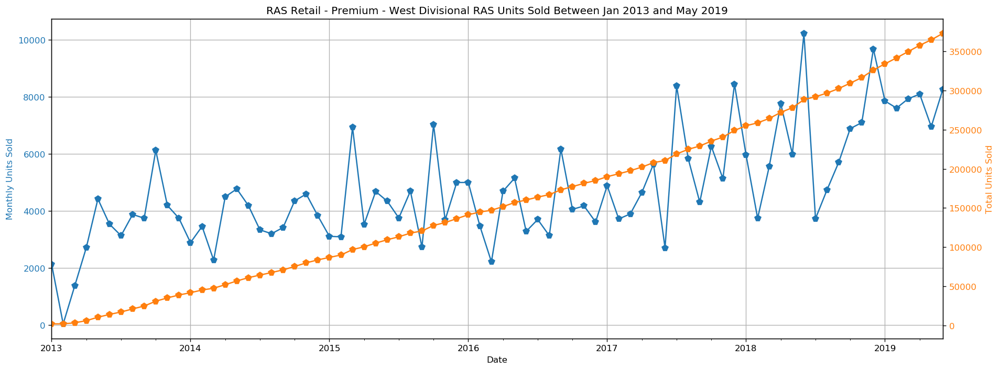

In [51]:
## Monthly Values (Continuous)
for category,localdata in pccatregyearmonthdata.items():
    f, ax1 = plt.subplots(1, 1, figsize=(16,6))
    #plotdata = localdata.sum()
    plotdata = localdata
    color = 'C0'
    ax1 = plotdata.plot(ax=ax1, grid=True, style='-p', ms=7, color=color)
    ax1.set_ylabel("Monthly Units Sold", color=color)
    ax1.set_xlabel("Date")
    ax1.tick_params(axis='y', labelcolor=color)    
    ax1.set_title("{0} Divisional RAS Units Sold Between Jan 2013 and May 2019".format(category))
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    plotdata = localdata.cumsum()
    color = 'C1'
    ax2.set_ylabel('Total Units Sold', color=color)  # we already handled the x-label with ax1
    ax2 = plotdata.plot(ax=ax2, style='-p', ms=7, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    f.tight_layout()  # otherwise the right y-label is slightly clipped  


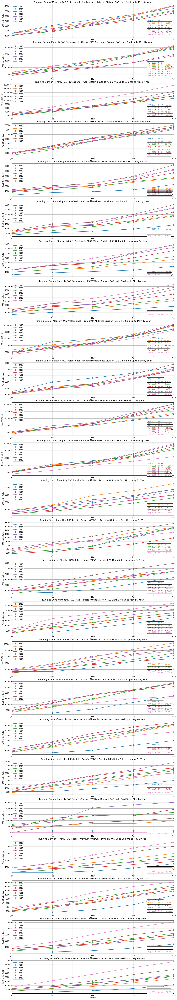

In [52]:
f, axs = plt.subplots(len(csums), 1, sharex=False, sharey=False, figsize=(16,100))

ir = 0
for category,csumdf in csums.items():

    csumdf.index = months
    axs[ir] = csumdf[:5].plot(ax=axs[ir], legend=True, style='-p', ms=7, grid=True)
    axs[ir].set_ylabel("RAS Units Sold")
    axs[ir].set_xlabel("Month")
    axs[ir].set_title("Running Sum of Monthly {0} Division RAS Units Sold Up to May By Year".format(category))
    if True:
        xs = [csumdf[y].iloc[4] for y in years]
        ts = ["May {0}".format(y) for y in years]
        ts = ["{0}: {1}M".format(ts[i], round(xs[i]/1e6, 2)) for i in range(len(xs))]
        for i in range(1,len(ts)):
            diff = round(100*(xs[i]/xs[i-1]-1),1)
            if diff > 0:
                ts[i] = "{0} (+{1}%)".format(ts[i], diff)
            else:
                ts[i] = "{0} ({1}%)".format(ts[i], diff)

        ymin = min(xs)
        for i in range(len(xs)):
            axs[ir].text(3.35, (0.75*ymin) - ymin*i/12, ts[i], {'color': "C{0}".format(i), 'fontsize': 10, 'bbox': dict(boxstyle="round", fc="white", ec="black", pad=0.35)}, va="top", ha="left")

    ir += 1

In [53]:
plotdata = DataFrame(pccatregyearmonthdata)
plotdata.to_pickle("Aggdata/ProfitCenterCategoryRegionSales.p")

In [54]:
plotdata

,RAS Professional - Contractor - Midwest,RAS Professional - Contractor - Northeast,RAS Professional - Contractor - South,RAS Professional - Contractor - West,RAS Professional - Elite - Midwest,RAS Professional - Elite - Northeast,RAS Professional - Elite - South,RAS Professional - Elite - West,RAS Professional - Premium - Midwest,RAS Professional - Premium - Northeast,RAS Professional - Premium - South,RAS Professional - Premium - West,RAS Retail - Basic - Midwest,RAS Retail - Basic - Northeast,RAS Retail - Basic - South,RAS Retail - Basic - West,RAS Retail - Comfort - Midwest,RAS Retail - Comfort - Northeast,RAS Retail - Comfort - South,RAS Retail - Comfort - West,RAS Retail - Contractor - West,RAS Retail - Premium - Midwest,RAS Retail - Premium - Northeast,RAS Retail - Premium - South,RAS Retail - Premium - West
2013-01-01,15469.0,5022.0,21555.0,18667.0,2050.0,3611.0,4023.0,3967.0,18334.0,14801.0,16190.0,22192.0,5891.0,2370.0,5215.0,3588.0,13591.0,2434.0,5817.0,5526.0,486.0,2222.0,1454.0,1825.0,2132.0
2013-02-01,15536.0,4243.0,18835.0,16540.0,5048.0,2409.0,4181.0,6024.0,32191.0,14808.0,19023.0,20861.0,6120.0,1.0,1396.0,77.0,108.0,0.0,302.0,43.0,0.0,0.0,0.0,252.0,34.0
2013-03-01,11369.0,5464.0,24629.0,17121.0,1644.0,1509.0,2641.0,4819.0,7698.0,6579.0,6934.0,9782.0,6829.0,3298.0,5196.0,4249.0,12001.0,3399.0,4965.0,3611.0,30.0,1877.0,1184.0,2087.0,1370.0
2013-04-01,10545.0,4570.0,22720.0,13593.0,3746.0,2263.0,3059.0,4936.0,9172.0,7898.0,12600.0,9901.0,9171.0,4471.0,10184.0,4314.0,19492.0,5896.0,10085.0,5079.0,0.0,4368.0,2485.0,4069.0,2715.0
2013-05-01,12306.0,4472.0,22127.0,14214.0,10645.0,4168.0,8234.0,6539.0,21223.0,9124.0,16224.0,19642.0,9808.0,5350.0,11731.0,5810.0,18059.0,5759.0,8949.0,5837.0,0.0,6229.0,4664.0,6633.0,4420.0
2013-06-01,14619.0,3489.0,18595.0,14375.0,7510.0,4352.0,6034.0,6880.0,14772.0,6980.0,8971.0,14643.0,7749.0,3809.0,10076.0,5300.0,19539.0,5918.0,10511.0,5740.0,792.0,2707.0,1680.0,3960.0,3537.0
2013-07-01,21798.0,6903.0,30320.0,12298.0,3398.0,3923.0,5147.0,5857.0,9034.0,9172.0,16813.0,12934.0,7651.0,3713.0,11315.0,4922.0,17326.0,4873.0,10285.0,5090.0,956.0,4552.0,2443.0,5298.0,3132.0
2013-08-01,13125.0,3027.0,16136.0,14158.0,6878.0,3241.0,4363.0,6199.0,15400.0,6844.0,11405.0,13942.0,10049.0,5362.0,10778.0,5505.0,19645.0,7996.0,11110.0,6019.0,1023.0,6596.0,3282.0,5724.0,3877.0
2013-09-01,11036.0,5439.0,14742.0,14197.0,8393.0,6273.0,6407.0,9151.0,20019.0,13583.0,15025.0,15550.0,6062.0,2620.0,8944.0,5145.0,19636.0,5518.0,10421.0,5808.0,0.0,4689.0,3024.0,6388.0,3744.0
2013-10-01,13684.0,6324.0,25639.0,16379.0,4632.0,2654.0,4160.0,5904.0,17402.0,7696.0,12306.0,11090.0,23011.0,12276.0,28864.0,15335.0,36921.0,10065.0,17346.0,8740.0,0.0,7925.0,5923.0,11416.0,6125.0


# Account Sales

In [30]:
majoraccounts = read_excel("Top 75 Distributors.xlsx")
majacc = list(majoraccounts.iloc[:,1].values)

FileNotFoundError: [Errno 2] No such file or directory: 'Top 75 Distributors.xlsx'

In [ ]:
totalsales = {}
nKeep = 10

majoraccountdata = salesdata[salesdata["Acct. Sold-To"].isin(majacc)]
for account,accountdata in majoraccountdata.groupby("Acct. Sold-To"):
    
    if account in ["Consumer Chamberlain", "Internal", "Ret-Distributors"]:
        continue
    
    totalsales[account] = accountdata[accountdata.columns[6:]].fillna(0).values.sum()/1e6

verymajacc = list(Series(totalsales).sort_values(ascending=True)[-1*nKeep:].index)
print(verymajacc)
majoraccountdata = majoraccountdata[majoraccountdata["Acct. Sold-To"].isin(verymajacc)]

totalsales = {}
for account,accountdata in majoraccountdata.groupby("Acct. Sold-To"):
    
    if account in ["Consumer Chamberlain", "Internal", "Ret-Distributors"]:
        continue
    
    totalsales[account] = accountdata[accountdata.columns[6:]].fillna(0).values.sum()/1e6
totalsales = Series(totalsales).sort_values(ascending=True)

In [ ]:
f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
totalsales.plot('barh')

In [ ]:
years = [2017, 2018, 2019]
qtrs  = [1, 2, 3, 4]

plotdata = {}
for account,accountdata in majoraccountdata.groupby("Acct. Sold-To"):
    
    if account in ["Consumer Chamberlain", "Internal", "Ret-Distributors"]:
        continue
    
    localdata = accountdata[accountdata.columns[6:]]
    plotdata[account] = localdata.sum()

accountsales = {}
accyearmonthdata = {}
accyeardata = {}
accyearqtrdata = {}
for account,accountdata in majoraccountdata.groupby("Acct. Sold-To"):

    if account in ["Consumer Chamberlain", "Internal", "Ret-Distributors"]:
        continue

    localdata = accountdata[accountdata.columns[6:]]
    localdata = localdata.fillna(0)
    accyearmonthdata[account] = localdata.sum()/1e6
    accountsales[account] = round(localdata.values.sum()/1e6,1)
    

    accyeardata[account] = {}
    accyearqtrdata[account] = {}
    
    rdata = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        localyeardata = localyeardata.fillna(0)
        sales = localyeardata.values.sum()/1e6
        rdata["{0}".format(year)] = sales
    accyeardata[account] = rdata

    rdata = {}
    for year in years:
        localyeardata = localdata[[x for x in localdata.columns if x.year == year]]
        for qtr in qtrs:
            if year == 2019 and qtr >= 2:
                break
            localqtrdata = localyeardata[[x for x in localyeardata.columns if pd.Timestamp(x).quarter == qtr]]
            localqtrdata = localqtrdata.fillna(0)
            sales = localqtrdata.values.sum()/1e6
            rdata["{0}-Qtr{1}".format(year,qtr)] = sales
    accyearqtrdata[account] = rdata
    
    
f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
DataFrame(accyeardata).plot(ax=ax1, legend=True)
f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
DataFrame(accyearqtrdata).plot(ax=ax1, legend=True)
f, (ax1) = plt.subplots(1, 1, figsize=(16,6))
DataFrame(accyearmonthdata).plot(ax=ax1, legend=True)

In [ ]:
ryqdf = DataFrame(accyearqtrdata)
ryqdf["Qtr Sum"] = ryqdf.sum(axis=1)
ryqdf["Qtr CuSum"] = ryqdf["Qtr Sum"].cumsum()
rsums = ryqdf.sum(axis=0)
rsums.iloc[-1] = None
regsums  = DataFrame(rsums, columns=["Accnt Sum"]).T
regiondf = ryqdf.append(regsums, ignore_index = False)
regiondf.round(1).style.applymap(color_negative_red)

In [ ]:
ryqdf = DataFrame(accyearqtrdata).diff()
ryqdf["Qtr Sum"] = ryqdf.sum(axis=1)
ryqdf["Qtr CuSum"] = ryqdf["Qtr Sum"].cumsum()
rsums = ryqdf.sum(axis=0)
rsums.iloc[-1] = None
regsums  = DataFrame(rsums, columns=["Accnt Sum"]).T
regiondf = ryqdf.append(regsums, ignore_index = False)
regiondf.round(1).style.applymap(color_negative_red).apply(highlight_max)

In [ ]:
ryqdf = DataFrame(accyearmonthdata).diff()
ryqdf["Month Sum"] = ryqdf.sum(axis=1)
ryqdf["Month CuSum"] = ryqdf["Month Sum"].cumsum()
rsums = ryqdf.sum(axis=0)
rsums.iloc[-1] = None
regsums  = DataFrame(rsums, columns=["Accnt Sum"]).T
regiondf = ryqdf.append(regsums, ignore_index = False)
regiondf.round(1).style.applymap(color_negative_red).apply(highlight_max)

In [ ]:
## Look at Units vs Sales
## Look year-over-year
## What are the not assigned channels and regions (Defered reveve)

In [145]:
from scipy import stats
import numpy as np
from numpy import sqrt

In [164]:
#x = np.linspace(-15, 15, 100)
x = [95, 56, 56, 76, 76]
avg = sum(x)/5
r = stats.norm.rvs(loc=avg, scale=sqrt(avg), size=10000)
stats.ks_2samp(x, r).pvalue
#stats.kstest(x, 'norm').pvalue


0.4063671465816169

In [163]:
r

array([68.69841091, 82.51639131, 65.11725976, ..., 94.23894937,
       54.6342152 , 79.15586482])

In [144]:
x

array([41.90185675, 41.97720994, 49.23767826, 55.70082885, 31.20903146,
       44.90373978, 53.90350587, 53.36962402, 38.47559373, 44.12634818,
       44.61987903, 51.36504376, 49.75889418, 57.06905252, 51.04882074,
       48.22414919, 46.75419349, 38.11032452, 45.01731258, 44.7587069 ,
       53.94971205, 51.14355378, 41.96327304, 31.53790482, 47.6178258 ,
       48.99018062, 54.66740856, 48.65181591, 56.94229085, 59.92821035,
       40.86283686, 53.81056883, 43.31013168, 48.98007892, 64.45546051,
       59.83409533, 57.91497406, 58.28492139, 47.90438541, 44.77788424,
       47.78437509, 57.91501378, 42.37327814, 52.03489495, 55.75667347,
       36.99578934, 52.9171624 , 59.35291805, 61.46318435, 61.58870302,
       31.08808474, 44.4632297 , 64.95174026, 61.81368163, 63.44133701,
       48.81382161, 51.88554199, 51.61186086, 54.94554997, 45.10213154,
       52.12764357, 50.83969646, 52.62870049, 53.00663138, 52.33362744,
       46.27754434, 53.56973432, 45.80522532, 48.73576151, 52.55

In [40]:
(1.32-1.30)/1.30

0.015384615384615398